# Data analisys for Path Loss characterization

---


<script
  src="https://cdn.mathjax.org/mathjax/latest/MathJax.js?config=TeX-AMS-MML_HTMLorMML"
  type="text/javascript">
</script>

Import libraries

In [2]:
import csv
import folium
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from pyubx2 import haversine
from scipy.optimize import curve_fit
from sklearn.linear_model import LinearRegression
# from mpl_toolkits.mplot3d import Axes3D

## GPS calibration 2D 

#### Relative position - Preview

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


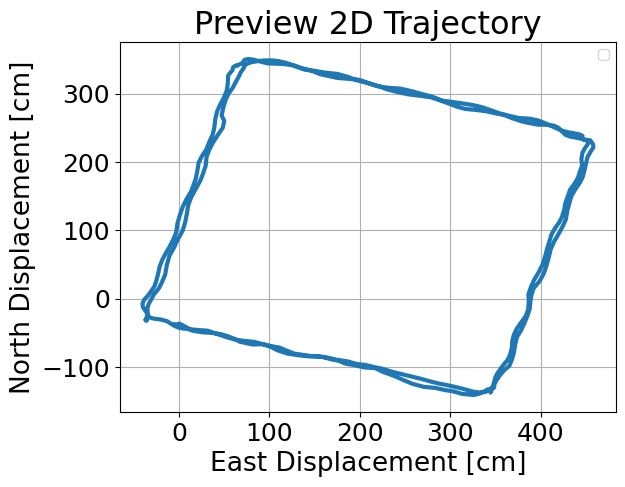

In [64]:
# Leer el archivo CSV
# Reemplaza con la ruta a tu archivo
file_path = '..\Data\Meas_GPS\GPS_MEAS_26-08-2025\GPS_MEAS_26-08-2025-15-22-11.csv'
#file_path = '..\Data\Meas_GPS\GPS_MEAS_26-08-2025-Distance\GPS_MEAS_26-08-2025-15-55-33.csv'
#file_path = '..\Data\Meas_GPS\GPS_MEAS_26-08-2025\GPS_MEAS_26-08-2025-15-19-37.csv'
df = pd.read_csv(file_path)
# Filtrar filas donde latitud, longitud y altitud son todas 0
absPos = df[df['pos_type'] == 'absPos']
relPos = df[df['pos_type'] == 'relPos']
# Supongamos que las columnas se llaman 'Latitud', 'Longitud' y 'Altitud'
latitudes = absPos['relPosE/lat']
longitudes = absPos['relPosN/lon']
altitudes = absPos['relPosD/height']
disN = relPos['relPosN/lon']
disE = relPos['relPosE/lat']
disD = relPos['relPosD/height']

base_station_point = np.array([-74.08188980, 4.63968460, 2578596])

# Calcular las distancias desde el punto inicial
distances = np.sqrt((latitudes - base_station_point[0])**2 +
                    (longitudes - base_station_point[1])**2 +
                    (altitudes - base_station_point[2])**2)


# Graficar el recorrido en 2D
plt.figure()
plt.plot(disE, disN, linewidth=3)
plt.ylabel('North Displacement [cm]', fontsize=19)
plt.xlabel('East Displacement [cm]', fontsize=19)
plt.title('Preview 2D Trajectory', fontsize=23)
plt.legend()
plt.grid()
plt.xticks(fontsize=18)
plt.yticks(fontsize=18)
# Mostrar la gráfica
plt.show()

## GPS calibration 2D 

#### Absolute position

### Rotating the trajectory

In [31]:
def rotate_coordinates(east_m, north_m, angle_degrees):
    """
    Rota las coordenadas east_m y north_m por un ángulo dado
    
    Args:
        east_m: Array de coordenadas Este en metros
        north_m: Array de coordenadas Norte en metros
        angle_degrees: Ángulo de rotación en grados (positivo = antihorario)
    
    Returns:
        Tupla (X, Y) con las coordenadas rotadas
    """
    # Convertir ángulo a radianes
    angle_rad = np.radians(angle_degrees)

    # Matriz de rotación 2D
    cos_theta = np.cos(angle_rad)
    sin_theta = np.sin(angle_rad)

    # Aplicar rotación
    X = east_m * cos_theta - north_m * sin_theta
    Y = east_m * sin_theta + north_m * cos_theta

    return X, Y


### Ejemplo de uso después de tener east_m y north_m calculados:

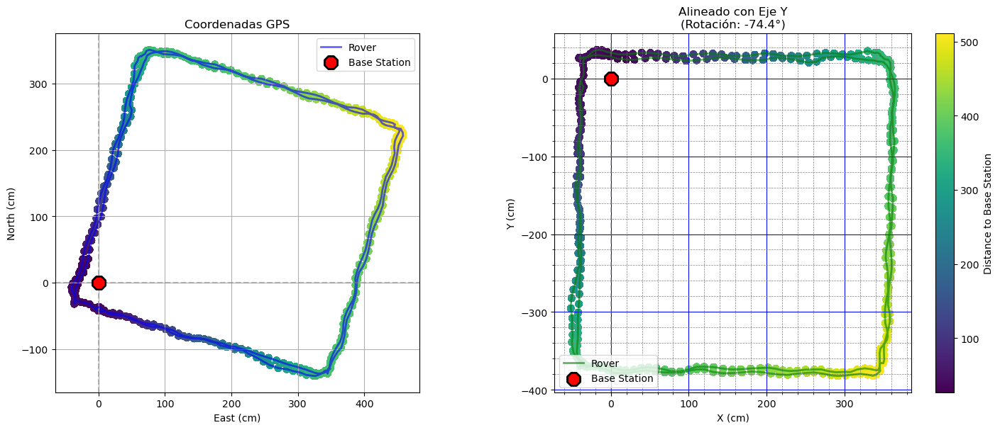

In [72]:
# Rotación de coordenadas disN y disE respecto al eje X
# Método simple y directo para alinear la trayectoria

disE = np.array(disE)
disN = np.array(disN)

# Calcular las distancias desde el origen para los datos de posición relativa
distances_rel = np.sqrt(disE**2 + disN**2)

# Calcular el ángulo desde el primer al último punto
direction_vector = np.array([disE[-1] - disE[0], disN[-1] - disN[0]])
angle_to_x_axis = np.degrees(np.arctan2(direction_vector[1], direction_vector[0]))

# Rotar para alinear con el eje X (ángulo objetivo = 0°)
rotation_angle_x = -angle_to_x_axis
X_aligned, Y_aligned = rotate_coordinates(disE, disN, rotation_angle_x)

# Rotar para alinear con el eje Y (ángulo objetivo = 90°)
rotation_angle_y = 90 - angle_to_x_axis
X_aligned_y, Y_aligned_y = rotate_coordinates(disE, disN, rotation_angle_y)

# Verificar los resultados
final_vector_x = np.array([X_aligned[-1] - X_aligned[0], Y_aligned[-1] - Y_aligned[0]])
final_angle_x = np.degrees(np.arctan2(final_vector_x[1], final_vector_x[0]))

final_vector_y = np.array([X_aligned_y[-1] - X_aligned_y[0], Y_aligned_y[-1] - Y_aligned_y[0]])
final_angle_y = np.degrees(np.arctan2(final_vector_y[1], final_vector_y[0]))

# Visualizar solo las dos opciones principales
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(15, 6))

# Original coordinates
scatter1 = ax1.scatter(disE, disN, c=distances_rel, cmap='viridis', s=40)
# plt.colorbar(scatter1, ax=ax1, label='Distance to Base Station')
ax1.plot(disE, disN, 'b-', alpha=0.6, linewidth=2, label="Rover")
# Base station
ax1.scatter(0, 0, color='red', s=200, marker='8', label='Base Station',
            edgecolors='black', linewidth=2, zorder=5)
ax1.set_xlabel('East (cm)')
ax1.set_ylabel('North (cm)')
# ax1.set_title(f'Coordenadas Originales\n(Ángulo: {angle_to_x_axis:.1f}°)')
ax1.set_title(f'Coordenadas GPS')
ax1.grid(True)
ax1.set_aspect('equal')
ax1.legend()

# Líneas de referencia
ax1.axhline(y=0, color='gray', linestyle='--', alpha=0.5)
ax1.axvline(x=0, color='gray', linestyle='--', alpha=0.5)

# Coordenadas rotadas - usar la mejor alineación
std_y_x = np.std(Y_aligned)
std_x_y = np.std(X_aligned_y)

# print(f'Desviación estándar Y alineado X: {std_y_x:.2f} cm')
# print(f'Desviación estándar X alineado Y: {std_x_y:.2f} cm')

distances_rel_x = np.sqrt(X_aligned**2 + Y_aligned**2)
distances_rel_y = np.sqrt(X_aligned_y**2 + Y_aligned_y**2)

if std_y_x < std_x_y:
    # Mejor alineación con eje X
    ax2.scatter(X_aligned, Y_aligned, c=distances_rel_x, cmap='viridis', s=40)
    ax2.plot(X_aligned, Y_aligned, 'r-', alpha=0.6, linewidth=2)
    ax2.scatter(0, 0, color='red', s=200, marker='8', label='Base Station',
                edgecolors='black', linewidth=2, zorder=5)
    scatter = ax2.scatter(X_aligned, Y_aligned, c=distances_rel_x, cmap='viridis', s=40)
    plt.colorbar(scatter, ax=ax2, label='Distance to Base Station')
    ax2.set_title(f'Alineado con Eje X\n(Rotación: {rotation_angle_x:.1f}°)')
    ax2.axhline(y=0, color='gray', linestyle='--', alpha=0.5)
    X_final, Y_final = X_aligned, Y_aligned
else:
    # Mejor alineación con eje Y
    ax2.scatter(X_aligned_y, Y_aligned_y, c=distances_rel_y, cmap='viridis', s=40)
    ax2.plot(X_aligned_y, Y_aligned_y, 'g-', alpha=0.6, linewidth=2, label="Rover")
    ax2.scatter(0, 0, color='red', s=200, marker='8', label='Base Station',
                edgecolors='black', linewidth=2, zorder=5)
    scatter = ax2.scatter(X_aligned_y, Y_aligned_y, c=distances_rel_y, cmap='viridis', s=40)
    plt.colorbar(scatter, ax=ax2, label='Distance to Base Station')
    ax2.set_title(f'Alineado con Eje Y\n(Rotación: {rotation_angle_y:.1f}°)')
    ax2.axvline(x=0, color='gray', linestyle='--', alpha=0.5)
    X_final, Y_final = X_aligned_y, Y_aligned_y

plt.minorticks_on()
ax2.set_xlabel('X (cm)')
ax2.set_ylabel('Y (cm)')
ax2.grid(which='major', color='blue', linestyle='-', linewidth=0.75)
ax2.grid(which='minor', color='gray', linestyle='--', linewidth=0.5)
ax2.set_aspect('equal')
ax2.legend(loc='lower left')

plt.tight_layout()
plt.show()

### Observación de variabilidad

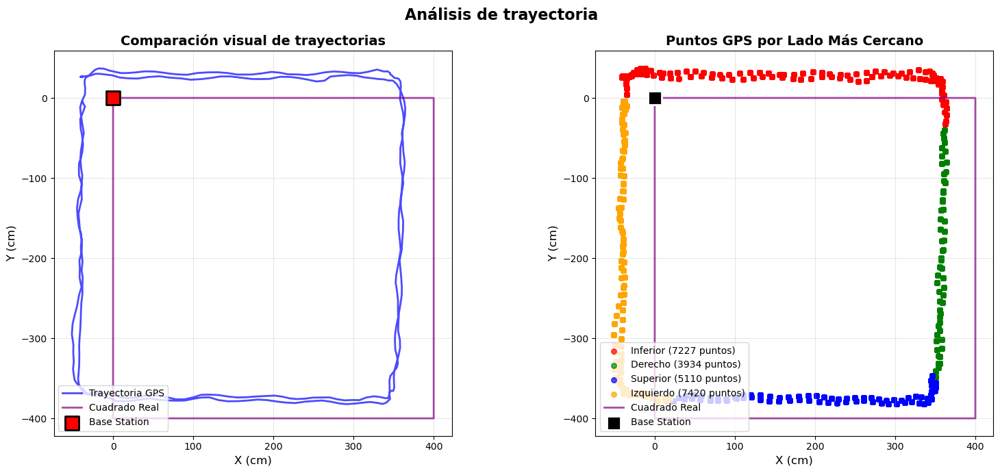

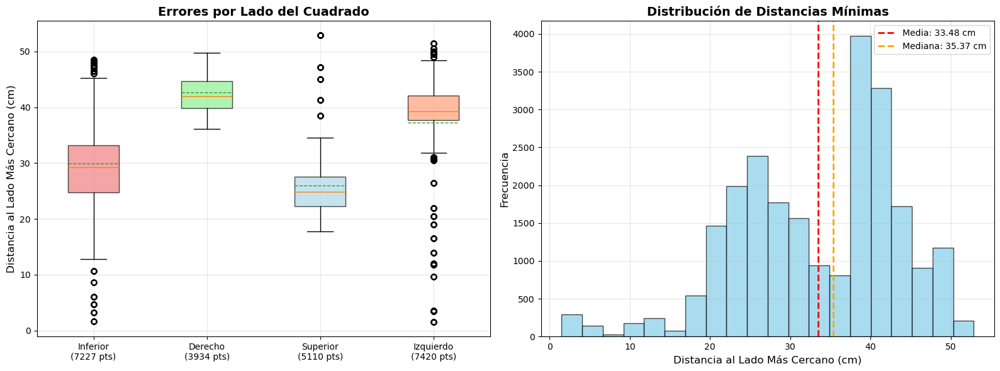

📊 ANÁLISIS ESTADÍSTICO: GPS vs LADOS DEL CUADRADO
🎯 DISTRIBUCIÓN POR LADOS:
   • Inferior: 7227 puntos (30.5%)
   • Derecho: 3934 puntos (16.6%)
   • Superior: 5110 puntos (21.6%)
   • Izquierdo: 7420 puntos (31.3%)

📏 ESTADÍSTICAS GENERALES (DISTANCIA A LADO MÁS CERCANO):
   • Error medio: 33.48 ± 10.03 cm
   • Mediana: 35.37 cm
   • Error mínimo: 1.49 cm
   • Error máximo: 52.88 cm

📊 ESTADÍSTICAS POR LADO:
   • Inferior:
     - Media: 29.95 ± 9.41 cm
     - Mediana: 29.29 cm
     - Rango: 1.71 - 48.48 cm
   • Derecho:
     - Media: 42.68 ± 3.40 cm
     - Mediana: 41.96 cm
     - Rango: 36.09 - 49.73 cm
   • Superior:
     - Media: 25.94 ± 6.33 cm
     - Mediana: 24.86 cm
     - Rango: 17.76 - 52.88 cm
   • Izquierdo:
     - Media: 37.25 ± 9.55 cm
     - Mediana: 39.24 cm
     - Rango: 1.49 - 51.38 cm

📐 RMSE (Root Mean Square Error):
   • RMSE Total: 34.96 cm

📊 PERCENTILES:
   • P25: 25.93 cm
   • P50 (Mediana): 35.37 cm
   • P75: 41.24 cm
   • P95: 47.91 cm


In [77]:
# Definir las esquinas del cuadrado
square_corners_x = np.array([0, 400, 400, 0, 0])
square_corners_y = np.array([0, 0, -400, -400, 0])

# Crear vectores del mismo tamaño que X_aligned_y, Y_aligned_y
n_points = len(X_aligned_y)


def create_square_path(corners_x, corners_y, n_points):
    """
    Crea un path de cuadrado con n_points distribuidos uniformemente en el perímetro
    """
    distances = [0]
    for i in range(1, len(corners_x)):
        dist = np.sqrt((corners_x[i] - corners_x[i-1])
                       ** 2 + (corners_y[i] - corners_y[i-1])**2)
        distances.append(distances[-1] + dist)

    total_distance = distances[-1]
    target_distances = np.linspace(0, total_distance, n_points)

    square_x = np.zeros(n_points)
    square_y = np.zeros(n_points)

    for i, target_dist in enumerate(target_distances):
        segment = 0
        for j in range(len(distances)-1):
            if distances[j] <= target_dist <= distances[j+1]:
                segment = j
                break

        if segment < len(corners_x)-1:
            t = (target_dist - distances[segment]) / \
                (distances[segment+1] - distances[segment])
            square_x[i] = corners_x[segment] + t * \
                (corners_x[segment+1] - corners_x[segment])
            square_y[i] = corners_y[segment] + t * \
                (corners_y[segment+1] - corners_y[segment])
        else:
            square_x[i] = corners_x[-1]
            square_y[i] = corners_y[-1]

    return square_x, square_y


def distance_point_to_line_segment(px, py, x1, y1, x2, y2):
    """
    Calcula la distancia perpendicular de un punto a un segmento de línea
    """
    # Vector del segmento
    dx = x2 - x1
    dy = y2 - y1

    # Si el segmento es un punto
    if dx == 0 and dy == 0:
        return np.sqrt((px - x1)**2 + (py - y1)**2)

    # Proyección del punto sobre la línea
    t = ((px - x1) * dx + (py - y1) * dy) / (dx**2 + dy**2)

    # Limitar t al segmento [0, 1]
    t = max(0, min(1, t))

    # Punto más cercano en el segmento
    closest_x = x1 + t * dx
    closest_y = y1 + t * dy

    # Distancia del punto al punto más cercano en el segmento
    return np.sqrt((px - closest_x)**2 + (py - closest_y)**2)


def calculate_distances_to_square_sides(gps_x, gps_y, corners_x, corners_y):
    """
    Calcula la distancia mínima de cada punto GPS a cualquier lado del cuadrado
    y también identifica a qué lado pertenece cada punto
    """
    n_points = len(gps_x)
    min_distances = np.zeros(n_points)
    closest_sides = np.zeros(n_points, dtype=int)
    side_names = ['Inferior', 'Derecho', 'Superior', 'Izquierdo']

    # Definir los 4 lados del cuadrado
    sides = [
        (corners_x[0], corners_y[0], corners_x[1],
         corners_y[1]),  # Lado inferior
        (corners_x[1], corners_y[1], corners_x[2],
         corners_y[2]),  # Lado derecho
        (corners_x[2], corners_y[2], corners_x[3],
         corners_y[3]),  # Lado superior
        (corners_x[3], corners_y[3], corners_x[0],
         corners_y[0])   # Lado izquierdo
    ]

    for i in range(n_points):
        distances_to_sides = []

        # Calcular distancia a cada lado
        for side in sides:
            x1, y1, x2, y2 = side
            dist = distance_point_to_line_segment(
                gps_x[i], gps_y[i], x1, y1, x2, y2)
            distances_to_sides.append(dist)

        # Encontrar el lado más cercano
        min_dist_idx = np.argmin(distances_to_sides)
        min_distances[i] = distances_to_sides[min_dist_idx]
        closest_sides[i] = min_dist_idx

    return min_distances, closest_sides, side_names


# Usar el método alternativo
square_x_alt, square_y_alt = create_square_path(
    square_corners_x, square_corners_y, n_points)

# =============================================================================
# ANÁLISIS ESTADÍSTICO - DISTANCIA A LADOS DEL RECORRIDO AL LADO MÁS CERCANO
# =============================================================================

# Calcular distancias mínimas a los lados del cuadrado
min_distances_to_sides, closest_sides, side_names = calculate_distances_to_square_sides(
    X_aligned_y, Y_aligned_y, square_corners_x, square_corners_y)

# Separar errores por lado
side_errors = {i: [] for i in range(4)}
for i, side_idx in enumerate(closest_sides):
    side_errors[side_idx].append(min_distances_to_sides[i])

# Convertir a arrays numpy
for side_idx in side_errors:
    side_errors[side_idx] = np.array(side_errors[side_idx])

# =============================================================================
# PRIMER GRÁFICO: Comparación visual de trayectorias
# =============================================================================
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(16, 7))

# Subplot 1: Trayectorias
ax1.plot(X_aligned_y, Y_aligned_y, 'b-', alpha=0.7,
         linewidth=2, label="Trayectoria GPS")
ax1.plot(square_x_alt, square_y_alt, 'purple',
         alpha=0.7, linewidth=2, label="Cuadrado Real")
ax1.scatter(0, 0, color='red', s=200, marker='s', label='Base Station',
            edgecolors='black', linewidth=2, zorder=5)
ax1.set_xlabel('X (cm)', fontsize=12)
ax1.set_ylabel('Y (cm)', fontsize=12)
ax1.set_title('Comparación visual de trayectorias',
              fontsize=14, fontweight='bold')
ax1.grid(True, alpha=0.3)
ax1.set_aspect('equal')
ax1.legend(loc='lower left')

# Subplot 2: Puntos coloreados por lado más cercano
colors_by_side = ['red', 'green', 'blue', 'orange']
for side_idx in range(4):
    mask = closest_sides == side_idx
    if np.any(mask):
        ax2.scatter(X_aligned_y[mask], Y_aligned_y[mask],
                    c=colors_by_side[side_idx], alpha=0.7, s=30,
                    label=f'{side_names[side_idx]} ({np.sum(mask)} puntos)')

ax2.plot(square_x_alt, square_y_alt, 'purple',
         alpha=0.7, linewidth=2, label="Cuadrado Real")
ax2.scatter(0, 0, color='black', s=200, marker='s', label='Base Station',
            edgecolors='white', linewidth=2, zorder=5)
ax2.set_xlabel('X (cm)', fontsize=12)
ax2.set_ylabel('Y (cm)', fontsize=12)
ax2.set_title('Puntos GPS por Lado Más Cercano',
              fontsize=14, fontweight='bold')
ax2.grid(True, alpha=0.3)
ax2.set_aspect('equal')
ax2.legend(loc='lower left')

fig.suptitle('Análisis de trayectoria',
             fontsize=16, fontweight='bold')
plt.tight_layout()
plt.show()

# =============================================================================
# SEGUNDO GRÁFICO: Análisis por lados
# =============================================================================
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(16, 6))

# Diagrama de cajas por lado
box_data_sides = []
box_labels_sides = []
for side_idx in range(4):
    if len(side_errors[side_idx]) > 0:
        box_data_sides.append(side_errors[side_idx])
        box_labels_sides.append(
            f'{side_names[side_idx]}\n({len(side_errors[side_idx])} pts)')

if box_data_sides:
    bp = ax1.boxplot(box_data_sides, labels=box_labels_sides,
                     patch_artist=True, showmeans=True, meanline=True)

    # Colorear las cajas
    colors = ['lightcoral', 'lightgreen', 'lightblue', 'lightsalmon']
    for i, patch in enumerate(bp['boxes']):
        if i < len(colors):
            patch.set_facecolor(colors[i])
            patch.set_alpha(0.7)

ax1.set_title('Errores por Lado del Cuadrado', fontsize=14, fontweight='bold')
ax1.set_ylabel('Distancia al Lado Más Cercano (cm)', fontsize=12)
ax1.grid(True, alpha=0.3)

# Histograma de todas las distancias mínimas
ax2.hist(min_distances_to_sides, bins=20, alpha=0.7, color='skyblue',
         edgecolor='black', linewidth=1)
ax2.axvline(x=min_distances_to_sides.mean(), color='red', linestyle='--',
            linewidth=2, label=f'Media: {min_distances_to_sides.mean():.2f} cm')
ax2.axvline(x=np.median(min_distances_to_sides), color='orange', linestyle='--',
            linewidth=2, label=f'Mediana: {np.median(min_distances_to_sides):.2f} cm')
ax2.set_title('Distribución de Distancias Mínimas',
              fontsize=14, fontweight='bold')
ax2.set_xlabel('Distancia al Lado Más Cercano (cm)', fontsize=12)
ax2.set_ylabel('Frecuencia', fontsize=12)
ax2.legend()
ax2.grid(True, alpha=0.3)

plt.tight_layout()
plt.show()


# =============================================================================
# ESTADÍSTICAS DETALLADAS POR LADOS
# =============================================================================
print("=" * 80)
print("📊 ANÁLISIS ESTADÍSTICO: GPS vs LADOS DEL CUADRADO")
print("=" * 80)

print("🎯 DISTRIBUCIÓN POR LADOS:")
for side_idx in range(4):
    count = len(side_errors[side_idx])
    percentage = (count / len(X_aligned_y)) * 100
    print(f"   • {side_names[side_idx]}: {count} puntos ({percentage:.1f}%)")

print(f"\n📏 ESTADÍSTICAS GENERALES (DISTANCIA A LADO MÁS CERCANO):")
print(
    f"   • Error medio: {min_distances_to_sides.mean():.2f} ± {min_distances_to_sides.std():.2f} cm")
print(f"   • Mediana: {np.median(min_distances_to_sides):.2f} cm")
print(f"   • Error mínimo: {min_distances_to_sides.min():.2f} cm")
print(f"   • Error máximo: {min_distances_to_sides.max():.2f} cm")

print(f"\n📊 ESTADÍSTICAS POR LADO:")
for side_idx in range(4):
    if len(side_errors[side_idx]) > 0:
        errors = side_errors[side_idx]
        print(f"   • {side_names[side_idx]}:")
        print(f"     - Media: {errors.mean():.2f} ± {errors.std():.2f} cm")
        print(f"     - Mediana: {np.median(errors):.2f} cm")
        print(f"     - Rango: {errors.min():.2f} - {errors.max():.2f} cm")

# RMSE total
rmse_sides = np.sqrt(np.mean(min_distances_to_sides**2))
print(f"\n📐 RMSE (Root Mean Square Error):")
print(f"   • RMSE Total: {rmse_sides:.2f} cm")

# Percentiles
print(f"\n📊 PERCENTILES:")
print(f"   • P25: {np.percentile(min_distances_to_sides, 25):.2f} cm")
print(
    f"   • P50 (Mediana): {np.percentile(min_distances_to_sides, 50):.2f} cm")
print(f"   • P75: {np.percentile(min_distances_to_sides, 75):.2f} cm")
print(f"   • P95: {np.percentile(min_distances_to_sides, 95):.2f} cm")

print("=" * 80)

### Comprobación de medidas del lado del cuadrado

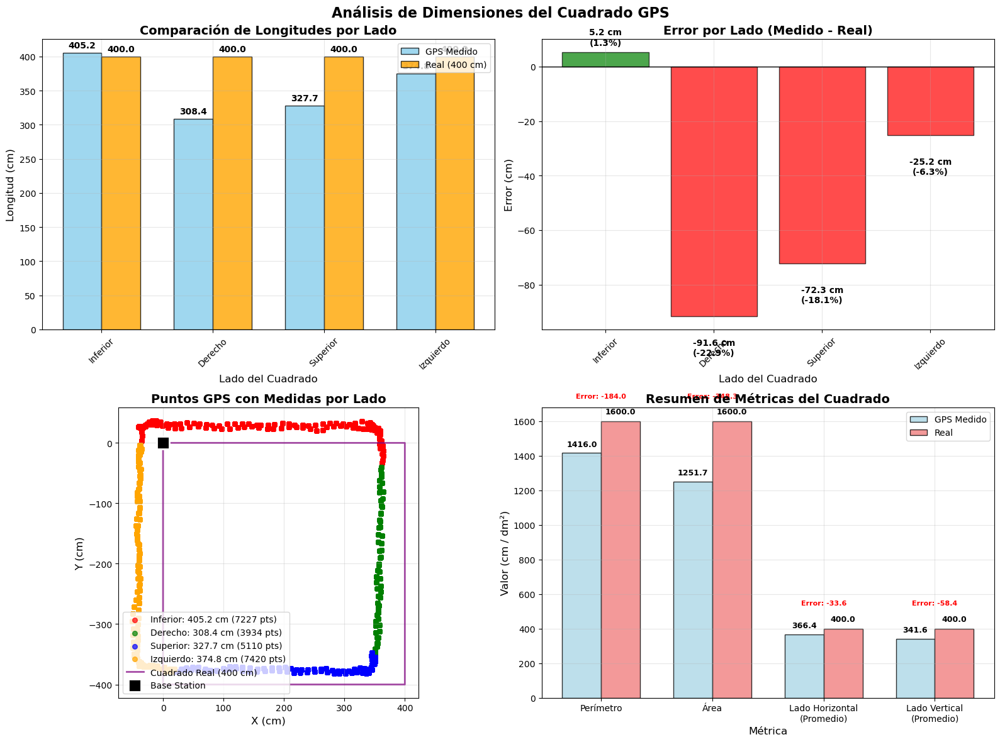

📐 ANÁLISIS DE DIMENSIONES: CUADRADO GPS vs CUADRADO REAL
🎯 MEDIDAS POR LADO:
   • Inferior:
     - Medido: 405.20 cm
     - Real: 400 cm
     - Error: 5.20 cm (1.30%)
     - Puntos utilizados: 7227
   • Derecho:
     - Medido: 308.38 cm
     - Real: 400 cm
     - Error: -91.62 cm (-22.90%)
     - Puntos utilizados: 3934
   • Superior:
     - Medido: 327.65 cm
     - Real: 400 cm
     - Error: -72.35 cm (-18.09%)
     - Puntos utilizados: 5110
   • Izquierdo:
     - Medido: 374.80 cm
     - Real: 400 cm
     - Error: -25.20 cm (-6.30%)
     - Puntos utilizados: 7420

📏 MÉTRICAS GENERALES:
   • Perímetro GPS: 1416.03 cm
   • Perímetro Real: 1600 cm
   • Error en perímetro: -183.97 cm (-11.50%)

📊 ÁREA:
   • Área GPS: 125166.74 cm²
   • Área Real: 160000 cm²
   • Error en área: -34833.26 cm² (-21.77%)

📐 PROMEDIOS POR ORIENTACIÓN:
   • Lados Horizontales (Inferior + Superior): 366.43 cm
   • Lados Verticales (Derecho + Izquierdo): 341.59 cm
   • Diferencia entre orientaciones: 24.84 cm

📊

In [78]:
# =============================================================================
# TERCER GRÁFICO: Análisis de medida de lados
# =============================================================================

def calculate_gps_square_sides(gps_x, gps_y, closest_sides):
    """
    Calcula las dimensiones de cada lado del cuadrado basado en los puntos GPS
    """
    side_measurements = {}
    side_names = ['Inferior', 'Derecho', 'Superior', 'Izquierdo']

    for side_idx in range(4):
        # Obtener puntos que pertenecen a este lado
        mask = closest_sides == side_idx
        if np.sum(mask) > 0:
            side_points_x = gps_x[mask]
            side_points_y = gps_y[mask]

            # Calcular la extensión del lado
            # Lados horizontales (Inferior y Superior)
            if side_idx == 0 or side_idx == 2:
                side_length = np.max(side_points_x) - np.min(side_points_x)
                side_start = np.min(side_points_x)
                side_end = np.max(side_points_x)
            else:  # Lados verticales (Derecho e Izquierdo)
                side_length = np.abs(
                    np.max(side_points_y) - np.min(side_points_y))
                side_start = np.max(
                    side_points_y) if side_idx == 1 else np.min(side_points_y)
                side_end = np.min(
                    side_points_y) if side_idx == 1 else np.max(side_points_y)

            side_measurements[side_idx] = {
                'name': side_names[side_idx],
                'length': side_length,
                'start': side_start,
                'end': side_end,
                'num_points': np.sum(mask),
                'points_x': side_points_x,
                'points_y': side_points_y
            }
        else:
            side_measurements[side_idx] = {
                'name': side_names[side_idx],
                'length': 0,
                'start': 0,
                'end': 0,
                'num_points': 0,
                'points_x': np.array([]),
                'points_y': np.array([])
            }

    return side_measurements


def calculate_square_perimeter_and_area(side_measurements):
    """
    Calcula el perímetro y área del cuadrado GPS
    """
    total_perimeter = sum([side['length']
                          for side in side_measurements.values()])

    # Para el área, usar promedio de lados opuestos
    horizontal_avg = (
        side_measurements[0]['length'] + side_measurements[2]['length']) / 2
    vertical_avg = (
        side_measurements[1]['length'] + side_measurements[3]['length']) / 2
    area = horizontal_avg * vertical_avg

    return total_perimeter, area, horizontal_avg, vertical_avg


# Calcular medidas de los lados del GPS
gps_side_measurements = calculate_gps_square_sides(
    X_aligned_y, Y_aligned_y, closest_sides)

# Calcular perímetro y área
gps_perimeter, gps_area, gps_horizontal_avg, gps_vertical_avg = calculate_square_perimeter_and_area(
    gps_side_measurements)

# Valores de referencia (cuadrado real)
real_side_length = 400  # cm
real_perimeter = 4 * real_side_length
real_area = real_side_length ** 2

# Calcular errores
side_length_errors = {}
for side_idx in range(4):
    measured_length = gps_side_measurements[side_idx]['length']
    error_abs = measured_length - real_side_length
    error_percent = (error_abs / real_side_length) * 100
    side_length_errors[side_idx] = {
        'measured': measured_length,
        'error_abs': error_abs,
        'error_percent': error_percent
    }

perimeter_error = gps_perimeter - real_perimeter
area_error = gps_area - real_area

# =============================================================================
# CREAR EL TERCER GRÁFICO
# =============================================================================
fig, ((ax1, ax2), (ax3, ax4)) = plt.subplots(2, 2, figsize=(16, 12))

# Subplot 1: Comparación de longitudes de lados
side_names = [gps_side_measurements[i]['name'] for i in range(4)]
measured_lengths = [gps_side_measurements[i]['length'] for i in range(4)]
real_lengths = [real_side_length] * 4

x_pos = np.arange(len(side_names))
width = 0.35

bars1 = ax1.bar(x_pos - width/2, measured_lengths, width, label='GPS Medido',
                color='skyblue', alpha=0.8, edgecolor='black')
bars2 = ax1.bar(x_pos + width/2, real_lengths, width, label='Real (400 cm)',
                color='orange', alpha=0.8, edgecolor='black')

# Agregar valores en las barras
for i, (measured, real) in enumerate(zip(measured_lengths, real_lengths)):
    ax1.text(i - width/2, measured + 5,
             f'{measured:.1f}', ha='center', va='bottom', fontweight='bold')
    ax1.text(i + width/2, real + 5, f'{real:.1f}',
             ha='center', va='bottom', fontweight='bold')

ax1.set_xlabel('Lado del Cuadrado', fontsize=12)
ax1.set_ylabel('Longitud (cm)', fontsize=12)
ax1.set_title('Comparación de Longitudes por Lado',
              fontsize=14, fontweight='bold')
ax1.set_xticks(x_pos)
ax1.set_xticklabels(side_names, rotation=45)
ax1.legend()
ax1.grid(True, alpha=0.3)

# Subplot 2: Errores por lado
error_values = [side_length_errors[i]['error_abs'] for i in range(4)]
colors = ['red' if err < 0 else 'green' for err in error_values]

bars = ax2.bar(side_names, error_values, color=colors,
               alpha=0.7, edgecolor='black')
ax2.axhline(y=0, color='black', linestyle='-', linewidth=1)

# Agregar valores en las barras
for i, (bar, error) in enumerate(zip(bars, error_values)):
    height = bar.get_height()
    ax2.text(bar.get_x() + bar.get_width()/2., height + (2 if height >= 0 else -8),
             f'{error:.1f} cm\n({side_length_errors[i]["error_percent"]:.1f}%)',
             ha='center', va='bottom' if height >= 0 else 'top', fontweight='bold')

ax2.set_xlabel('Lado del Cuadrado', fontsize=12)
ax2.set_ylabel('Error (cm)', fontsize=12)
ax2.set_title('Error por Lado (Medido - Real)', fontsize=14, fontweight='bold')
ax2.tick_params(axis='x', rotation=45)
ax2.grid(True, alpha=0.3)

# Subplot 3: Distribución de puntos por lado con medidas
colors_by_side = ['red', 'green', 'blue', 'orange']
for side_idx in range(4):
    side_data = gps_side_measurements[side_idx]
    if side_data['num_points'] > 0:
        ax3.scatter(side_data['points_x'], side_data['points_y'],
                    c=colors_by_side[side_idx], alpha=0.7, s=30,
                    label=f"{side_data['name']}: {side_data['length']:.1f} cm ({side_data['num_points']} pts)")

ax3.plot(square_x_alt, square_y_alt, 'purple', alpha=0.7,
         linewidth=2, label="Cuadrado Real (400 cm)")
ax3.scatter(0, 0, color='black', s=200, marker='s', label='Base Station',
            edgecolors='white', linewidth=2, zorder=5)

ax3.set_xlabel('X (cm)', fontsize=12)
ax3.set_ylabel('Y (cm)', fontsize=12)
ax3.set_title('Puntos GPS con Medidas por Lado',
              fontsize=14, fontweight='bold')
ax3.grid(True, alpha=0.3)
ax3.set_aspect('equal')
ax3.legend(loc='lower left', fontsize=10)

# Subplot 4: Resumen de métricas
metrics_labels = ['Perímetro', 'Área',
                  'Lado Horizontal\n(Promedio)', 'Lado Vertical\n(Promedio)']
measured_values = [gps_perimeter, gps_area/100, gps_horizontal_avg,
                   gps_vertical_avg]  # Área en dm² para visualización
real_values = [real_perimeter, real_area /
               100, real_side_length, real_side_length]
errors = [perimeter_error, area_error/100, gps_horizontal_avg -
          real_side_length, gps_vertical_avg - real_side_length]

x_pos_metrics = np.arange(len(metrics_labels))
bars1 = ax4.bar(x_pos_metrics - width/2, measured_values, width, label='GPS Medido',
                color='lightblue', alpha=0.8, edgecolor='black')
bars2 = ax4.bar(x_pos_metrics + width/2, real_values, width, label='Real',
                color='lightcoral', alpha=0.8, edgecolor='black')

# Agregar valores y errores
for i, (measured, real, error) in enumerate(zip(measured_values, real_values, errors)):
    ax4.text(i - width/2, measured + max(measured_values)*0.02, f'{measured:.1f}',
             ha='center', va='bottom', fontsize=9, fontweight='bold')
    ax4.text(i + width/2, real + max(real_values)*0.02, f'{real:.1f}',
             ha='center', va='bottom', fontsize=9, fontweight='bold')
    # Mostrar error
    ax4.text(i, max(measured, real) + max(max(measured_values), max(real_values))*0.08,
             f'Error: {error:.1f}', ha='center', va='bottom', fontsize=8,
             color='red' if error < 0 else 'green', fontweight='bold')

ax4.set_xlabel('Métrica', fontsize=12)
ax4.set_ylabel('Valor (cm / dm²)', fontsize=12)
ax4.set_title('Resumen de Métricas del Cuadrado',
              fontsize=14, fontweight='bold')
ax4.set_xticks(x_pos_metrics)
ax4.set_xticklabels(metrics_labels, fontsize=10)
ax4.legend()
ax4.grid(True, alpha=0.3)

plt.suptitle('Análisis de Dimensiones del Cuadrado GPS',
             fontsize=16, fontweight='bold')
plt.tight_layout()
plt.show()

# =============================================================================
# ESTADÍSTICAS DETALLADAS DE MEDIDAS
# =============================================================================
print("=" * 80)
print("📐 ANÁLISIS DE DIMENSIONES: CUADRADO GPS vs CUADRADO REAL")
print("=" * 80)

print("🎯 MEDIDAS POR LADO:")
for side_idx in range(4):
    side_data = gps_side_measurements[side_idx]
    error_data = side_length_errors[side_idx]
    print(f"   • {side_data['name']}:")
    print(f"     - Medido: {side_data['length']:.2f} cm")
    print(f"     - Real: {real_side_length} cm")
    print(
        f"     - Error: {error_data['error_abs']:.2f} cm ({error_data['error_percent']:.2f}%)")
    print(f"     - Puntos utilizados: {side_data['num_points']}")

print(f"\n📏 MÉTRICAS GENERALES:")
print(f"   • Perímetro GPS: {gps_perimeter:.2f} cm")
print(f"   • Perímetro Real: {real_perimeter} cm")
print(
    f"   • Error en perímetro: {perimeter_error:.2f} cm ({(perimeter_error/real_perimeter)*100:.2f}%)")

print(f"\n📊 ÁREA:")
print(f"   • Área GPS: {gps_area:.2f} cm²")
print(f"   • Área Real: {real_area} cm²")
print(
    f"   • Error en área: {area_error:.2f} cm² ({(area_error/real_area)*100:.2f}%)")

print(f"\n📐 PROMEDIOS POR ORIENTACIÓN:")
print(
    f"   • Lados Horizontales (Inferior + Superior): {gps_horizontal_avg:.2f} cm")
print(
    f"   • Lados Verticales (Derecho + Izquierdo): {gps_vertical_avg:.2f} cm")
print(
    f"   • Diferencia entre orientaciones: {abs(gps_horizontal_avg - gps_vertical_avg):.2f} cm")

# Estadísticas de precisión
all_errors = [side_length_errors[i]['error_abs'] for i in range(4)]
rmse_sides_length = np.sqrt(np.mean([err**2 for err in all_errors]))

print(f"\n📊 ESTADÍSTICAS DE ERROR:")
print(f"   • Error promedio: {np.mean(all_errors):.2f} cm")
print(f"   • Error máximo: {max(all_errors):.2f} cm")
print(f"   • Error mínimo: {min(all_errors):.2f} cm")
print(f"   • RMSE de longitudes: {rmse_sides_length:.2f} cm")
print(f"   • Desviación estándar: {np.std(all_errors):.2f} cm")

print("=" * 80)

### Observacion de variabilidad - Superponiendo el recorrido real


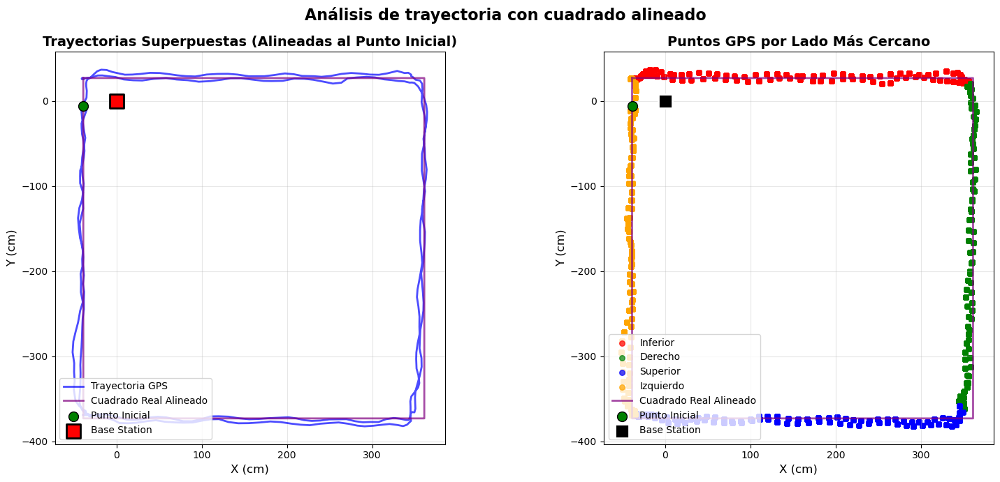

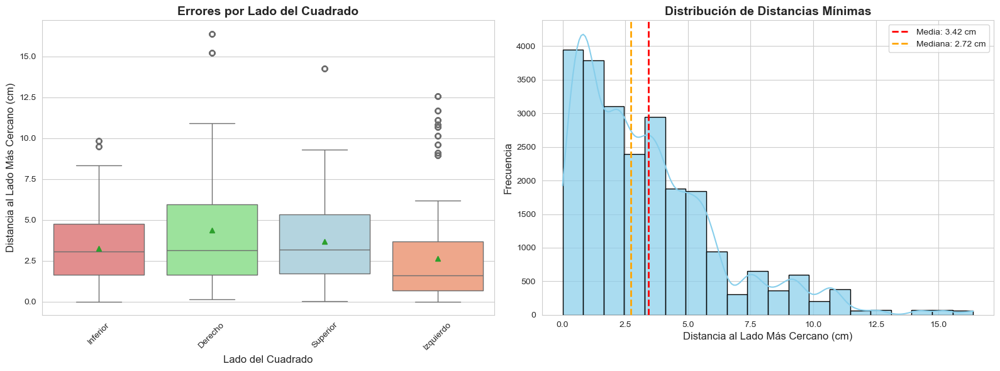

📊 ANÁLISIS ESTADÍSTICO: GPS vs LADOS DEL CUADRADO ALINEADO
🎯 ALINEACIÓN APLICADA:
   • Offset X: -38.83 cm
   • Offset Y: 27.04 cm
   • Punto inicial GPS: (-38.83, -6.07)
   • Punto inicial cuadrado alineado: (-38.83, 27.04)

🎯 DISTRIBUCIÓN POR LADOS:
   • Inferior: 5708 puntos (24.1%)
   • Derecho: 4970 puntos (21.0%)
   • Superior: 6121 puntos (25.8%)
   • Izquierdo: 6892 puntos (29.1%)

📏 ESTADÍSTICAS GENERALES (DISTANCIA A LADO MÁS CERCANO):
   • Error medio: 3.42 ± 2.87 cm
   • Mediana: 2.72 cm
   • Error mínimo: 0.00 cm
   • Error máximo: 16.39 cm

📊 ESTADÍSTICAS POR LADO:
   • Inferior:
     - Media: 3.24 ± 2.10 cm
     - Mediana: 3.05 cm
     - Rango: 0.00 - 9.82 cm
   • Derecho:
     - Media: 4.36 ± 3.63 cm
     - Mediana: 3.13 cm
     - Rango: 0.15 - 16.39 cm
   • Superior:
     - Media: 3.69 ± 2.62 cm
     - Mediana: 3.19 cm
     - Rango: 0.01 - 14.26 cm
   • Izquierdo:
     - Media: 2.65 ± 2.80 cm
     - Mediana: 1.59 cm
     - Rango: 0.00 - 12.56 cm

📐 RMSE (Root Mean Squa

In [87]:
import seaborn as sns
# ...existing imports...

# Definir las esquinas del cuadrado
square_corners_x = np.array([0, 400, 400, 0, 0])
square_corners_y = np.array([0, 0, -400, -400, 0])

# Crear vectores del mismo tamaño que X_aligned_y, Y_aligned_y
n_points = len(X_aligned_y)


def create_square_path(corners_x, corners_y, n_points):
    """
    Crea un path de cuadrado con n_points distribuidos uniformemente en el perímetro
    """
    distances = [0]
    for i in range(1, len(corners_x)):
        dist = np.sqrt((corners_x[i] - corners_x[i-1])
                       ** 2 + (corners_y[i] - corners_y[i-1])**2)
        distances.append(distances[-1] + dist)

    total_distance = distances[-1]
    target_distances = np.linspace(0, total_distance, n_points)

    square_x = np.zeros(n_points)
    square_y = np.zeros(n_points)

    for i, target_dist in enumerate(target_distances):
        segment = 0
        for j in range(len(distances)-1):
            if distances[j] <= target_dist <= distances[j+1]:
                segment = j
                break

        if segment < len(corners_x)-1:
            t = (target_dist - distances[segment]) / \
                (distances[segment+1] - distances[segment])
            square_x[i] = corners_x[segment] + t * \
                (corners_x[segment+1] - corners_x[segment])
            square_y[i] = corners_y[segment] + t * \
                (corners_y[segment+1] - corners_y[segment])
        else:
            square_x[i] = corners_x[-1]
            square_y[i] = corners_y[-1]

    return square_x, square_y


def distance_point_to_line_segment(px, py, x1, y1, x2, y2):
    """
    Calcula la distancia perpendicular de un punto a un segmento de línea
    """
    # Vector del segmento
    dx = x2 - x1
    dy = y2 - y1

    # Si el segmento es un punto
    if dx == 0 and dy == 0:
        return np.sqrt((px - x1)**2 + (py - y1)**2)

    # Proyección del punto sobre la línea
    t = ((px - x1) * dx + (py - y1) * dy) / (dx**2 + dy**2)

    # Limitar t al segmento [0, 1]
    t = max(0, min(1, t))

    # Punto más cercano en el segmento
    closest_x = x1 + t * dx
    closest_y = y1 + t * dy

    # Distancia del punto al punto más cercano en el segmento
    return np.sqrt((px - closest_x)**2 + (py - closest_y)**2)


def calculate_distances_to_square_sides(gps_x, gps_y, corners_x, corners_y):
    """
    Calcula la distancia mínima de cada punto GPS a cualquier lado del cuadrado
    y también identifica a qué lado pertenece cada punto
    """
    n_points = len(gps_x)
    min_distances = np.zeros(n_points)
    closest_sides = np.zeros(n_points, dtype=int)
    side_names = ['Inferior', 'Derecho', 'Superior', 'Izquierdo']

    # Definir los 4 lados del cuadrado
    sides = [
        (corners_x[0], corners_y[0], corners_x[1],
         corners_y[1]),  # Lado inferior
        (corners_x[1], corners_y[1], corners_x[2],
         corners_y[2]),  # Lado derecho
        (corners_x[2], corners_y[2], corners_x[3],
         corners_y[3]),  # Lado superior
        (corners_x[3], corners_y[3], corners_x[0],
         corners_y[0])   # Lado izquierdo
    ]

    for i in range(n_points):
        distances_to_sides = []

        # Calcular distancia a cada lado
        for side in sides:
            x1, y1, x2, y2 = side
            dist = distance_point_to_line_segment(
                gps_x[i], gps_y[i], x1, y1, x2, y2)
            distances_to_sides.append(dist)

        # Encontrar el lado más cercano
        min_dist_idx = np.argmin(distances_to_sides)
        min_distances[i] = distances_to_sides[min_dist_idx]
        closest_sides[i] = min_dist_idx

    return min_distances, closest_sides, side_names


# ALINEAR EL CUADRADO REAL CON EL PRIMER PUNTO GPS
# Usar el método alternativo para crear el cuadrado de referencia
square_x_alt, square_y_alt = create_square_path(
    square_corners_x, square_corners_y, n_points)

# Calcular el offset para alinear el cuadrado con el primer punto GPS
# offset_x = X_aligned_y[0] - square_x_alt[0]
# offset_y = Y_aligned_y[0] - square_y_alt[0]

# ALINEAR EL CUADRADO REAL CON EL ÚLTIMO PUNTO GPS
# Usar el método alternativo para crear el cuadrado de referencia
offset_x = X_aligned_y[-1] - square_x_alt[-1]
offset_y = Y_aligned_y[-1] - square_y_alt[-1]

# Aplicar el offset al cuadrado de referencia
square_x_aligned = square_x_alt + offset_x
square_y_aligned = square_y_alt + offset_y

# También aplicar el offset a las esquinas del cuadrado para los cálculos
square_corners_x_aligned = square_corners_x + offset_x
square_corners_y_aligned = square_corners_y + offset_y

# =============================================================================
# ANÁLISIS ESTADÍSTICO - DISTANCIA A LADOS DEL RECORRIDO AL LADO MÁS CERCANO
# =============================================================================

# Calcular distancias mínimas a los lados del cuadrado ALINEADO
min_distances_to_sides, closest_sides, side_names = calculate_distances_to_square_sides(
    X_aligned_y, Y_aligned_y, square_corners_x_aligned, square_corners_y_aligned)

# Separar errores por lado
side_errors = {i: [] for i in range(4)}
for i, side_idx in enumerate(closest_sides):
    side_errors[side_idx].append(min_distances_to_sides[i])

# Convertir a arrays numpy
for side_idx in side_errors:
    side_errors[side_idx] = np.array(side_errors[side_idx])

# =============================================================================
# PRIMER GRÁFICO: Comparación visual de trayectorias con Matplotlib
# =============================================================================
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(16, 7))

# Subplot 1: Trayectorias superpuestas
ax1.plot(X_aligned_y, Y_aligned_y, 'b-', alpha=0.7,
         linewidth=2, label="Trayectoria GPS")
ax1.plot(square_x_aligned, square_y_aligned, 'purple',
         alpha=0.7, linewidth=2, label="Cuadrado Real Alineado")
ax1.scatter(X_aligned_y[0], Y_aligned_y[0], color='green', s=100, marker='o',
            label='Punto Inicial', edgecolors='black', linewidth=1, zorder=6)
ax1.scatter(0, 0, color='red', s=200, marker='s',
            label='Base Station', edgecolors='black', linewidth=2, zorder=5)
ax1.set_xlabel('X (cm)', fontsize=12)
ax1.set_ylabel('Y (cm)', fontsize=12)
ax1.set_title('Trayectorias Superpuestas (Alineadas al Punto Inicial)',
              fontsize=14, fontweight='bold')
ax1.grid(True, alpha=0.3)
ax1.set_aspect('equal')
ax1.legend(loc='lower left')

# Subplot 2: Puntos coloreados por lado más cercano
colors_by_side = ['red', 'green', 'blue', 'orange']
for side_idx in range(4):
    mask = closest_sides == side_idx
    if np.any(mask):
        ax2.scatter(X_aligned_y[mask], Y_aligned_y[mask],
                    c=colors_by_side[side_idx], alpha=0.7, s=30,
                    label=f'{side_names[side_idx]}')
                    # label=f'{side_names[side_idx]} ({np.sum(mask)} puntos)')

ax2.plot(square_x_aligned, square_y_aligned, 'purple',
         alpha=0.7, linewidth=2, label="Cuadrado Real Alineado")
ax2.scatter(X_aligned_y[0], Y_aligned_y[0], color='green', s=100, marker='o',
            label='Punto Inicial', edgecolors='black', linewidth=1, zorder=6)
ax2.scatter(0, 0, color='black', s=200, marker='s',
            label='Base Station', edgecolors='white', linewidth=2, zorder=5)
ax2.set_xlabel('X (cm)', fontsize=12)
ax2.set_ylabel('Y (cm)', fontsize=12)
ax2.set_title('Puntos GPS por Lado Más Cercano',
              fontsize=14, fontweight='bold')
ax2.grid(True, alpha=0.3)
ax2.set_aspect('equal')
ax2.legend(loc='lower left')

fig.suptitle('Análisis de trayectoria con cuadrado alineado',
             fontsize=16, fontweight='bold')
plt.tight_layout()
plt.show()

# =============================================================================
# SEGUNDO GRÁFICO: Análisis por lados usando SEABORN
# =============================================================================
# Preparar datos para seaborn
data_for_seaborn = []
for side_idx in range(4):
    if len(side_errors[side_idx]) > 0:
        for error in side_errors[side_idx]:
            data_for_seaborn.append({
                'Lado': side_names[side_idx],
                'Error': error,
                'Num_Puntos': len(side_errors[side_idx])
            })

df_errors = pd.DataFrame(data_for_seaborn)

# Configurar estilo de seaborn
sns.set_style("whitegrid")
plt.rcParams.update({'font.size': 10})

fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(16, 6))

# Subplot 1: Boxplot con seaborn
if not df_errors.empty:
    box_plot = sns.boxplot(data=df_errors, x='Lado', y='Error', ax=ax1,
                           hue='Lado', palette=['lightcoral', 'lightgreen', 'lightblue', 'lightsalmon'],
                           legend=False, showmeans=True)

    # Personalizar el boxplot
    ax1.set_title('Errores por Lado del Cuadrado',
                  fontsize=14, fontweight='bold')
    ax1.set_ylabel('Distancia al Lado Más Cercano (cm)', fontsize=12)
    ax1.set_xlabel('Lado del Cuadrado', fontsize=12)
    ax1.tick_params(axis='x', rotation=45)

    # Agregar información de número de puntos
    # for i, side in enumerate(side_names):
    #     if side in df_errors['Lado'].values:
    #         num_points = df_errors[df_errors['Lado']
    #                                == side]['Num_Puntos'].iloc[0]
    #         ax1.text(i, ax1.get_ylim()[1] * 0.85, f'n={num_points}',
    #                  ha='center', va='top', fontweight='bold', fontsize=9)

# Subplot 2: Histograma con seaborn
sns.histplot(data=min_distances_to_sides, bins=20, alpha=0.7, color='skyblue',
             edgecolor='black', ax=ax2, kde=True)

# Agregar líneas de referencia
ax2.axvline(x=min_distances_to_sides.mean(), color='red', linestyle='--',
            linewidth=2, label=f'Media: {min_distances_to_sides.mean():.2f} cm')
ax2.axvline(x=np.median(min_distances_to_sides), color='orange', linestyle='--',
            linewidth=2, label=f'Mediana: {np.median(min_distances_to_sides):.2f} cm')

ax2.set_title('Distribución de Distancias Mínimas',
              fontsize=14, fontweight='bold')
ax2.set_xlabel('Distancia al Lado Más Cercano (cm)', fontsize=12)
ax2.set_ylabel('Frecuencia', fontsize=12)
ax2.legend()

plt.tight_layout()
plt.show()

# Resetear estilo de seaborn
sns.reset_defaults()

# =============================================================================
# ESTADÍSTICAS DETALLADAS POR LADOS
# =============================================================================
print("=" * 80)
print("📊 ANÁLISIS ESTADÍSTICO: GPS vs LADOS DEL CUADRADO ALINEADO")
print("=" * 80)

print(f"🎯 ALINEACIÓN APLICADA:")
print(f"   • Offset X: {offset_x:.2f} cm")
print(f"   • Offset Y: {offset_y:.2f} cm")
print(f"   • Punto inicial GPS: ({X_aligned_y[0]:.2f}, {Y_aligned_y[0]:.2f})")
print(
    f"   • Punto inicial cuadrado alineado: ({square_x_aligned[0]:.2f}, {square_y_aligned[0]:.2f})")

print(f"\n🎯 DISTRIBUCIÓN POR LADOS:")
for side_idx in range(4):
    count = len(side_errors[side_idx])
    percentage = (count / len(X_aligned_y)) * 100
    print(f"   • {side_names[side_idx]}: {count} puntos ({percentage:.1f}%)")

print(f"\n📏 ESTADÍSTICAS GENERALES (DISTANCIA A LADO MÁS CERCANO):")
print(
    f"   • Error medio: {min_distances_to_sides.mean():.2f} ± {min_distances_to_sides.std():.2f} cm")
print(f"   • Mediana: {np.median(min_distances_to_sides):.2f} cm")
print(f"   • Error mínimo: {min_distances_to_sides.min():.2f} cm")
print(f"   • Error máximo: {min_distances_to_sides.max():.2f} cm")

print(f"\n📊 ESTADÍSTICAS POR LADO:")
for side_idx in range(4):
    if len(side_errors[side_idx]) > 0:
        errors = side_errors[side_idx]
        print(f"   • {side_names[side_idx]}:")
        print(f"     - Media: {errors.mean():.2f} ± {errors.std():.2f} cm")
        print(f"     - Mediana: {np.median(errors):.2f} cm")
        print(f"     - Rango: {errors.min():.2f} - {errors.max():.2f} cm")

# RMSE total
rmse_sides = np.sqrt(np.mean(min_distances_to_sides**2))
print(f"\n📐 RMSE (Root Mean Square Error):")
print(f"   • RMSE Total: {rmse_sides:.2f} cm")

# Percentiles
print(f"\n📊 PERCENTILES:")
print(f"   • P25: {np.percentile(min_distances_to_sides, 25):.2f} cm")
print(
    f"   • P50 (Mediana): {np.percentile(min_distances_to_sides, 50):.2f} cm")
print(f"   • P75: {np.percentile(min_distances_to_sides, 75):.2f} cm")
print(f"   • P95: {np.percentile(min_distances_to_sides, 95):.2f} cm")

print("=" * 80)

Calculo de la distancia entre dos puntos geográficos usando la [fórmula de Haversine](http://www.movable-type.co.uk/scripts/latlong.html).

In [56]:
def haversine_distance(lat1, lon1, lat2, lon2):
    """
    Calcula la distancia entre dos puntos geográficos usando pyubx2.haversine.
    Funciona con arrays de NumPy, Series de pandas y valores escalares.
    
    Args:
        lat1, lon1: Latitud y longitud del primer punto (en grados)
        lat2, lon2: Latitud y longitud del segundo punto (en grados)
    
    Returns:
        float o array: Distancia en metros
    """
    # Si son Series de pandas o arrays, convertir y procesar elemento por elemento
    if hasattr(lat1, '__iter__') and not isinstance(lat1, str):
        lat1_array = np.array(lat1)
        lon1_array = np.array(lon1)
        
        # Crear array de resultados
        distances = np.zeros(len(lat1_array))
        
        # Calcular distancia para cada punto usando pyubx2.haversine
        for i in range(len(lat1_array)):
            # pyubx2.haversine devuelve distancia en km, convertir a metros
            distances[i] = haversine(lat1_array[i], lon1_array[i], lat2, lon2) * 1000
        
        return distances
    else:
        # Para valores escalares, usar directamente pyubx2.haversine y convertir a metros
        return haversine(lat1, lon1, lat2, lon2) #* 1000

In [73]:
# Leer el archivo CSV
# file_path = '..\Data\Meas_GPS\GPS_MEAS_30-07-2024-16-25-35.csv'
# df = pd.read_csv(file_path)


# Filtrar filas donde pos_type es 'absPos'
absPos = df[df['pos_type'] == 'absPos']
print(f"Número de filas absPos: {len(absPos)}")

# Extraer coordenadas
latitudes = absPos['relPosE/lat']  # Latitudes
longitudes = absPos['relPosN/lon']  # Longitudes  
altitudes = absPos['relPosD/height']   # Altitudes

print(f"Rango de latitudes: {latitudes.min():.6f} a {latitudes.max():.6f}")
print(f"Rango de longitudes: {longitudes.min():.6f} a {longitudes.max():.6f}")
print(f"Rango de altitudes: {altitudes.min():.0f} a {altitudes.max():.0f}")

# Punto de la estación base (longitud, latitud, altitud)
base_station_point = [-74.0827278, 4.6388707, 2589131]

# Calcular las distancias desde la estación base usando pyubx2.haversine
print("Calculando distancias usando pyubx2.haversine...")
distances = haversine_distance(
    latitudes, longitudes, 
    base_station_point[1], base_station_point[0])  # Nota: base_station[1] es lat, base_station[0] es lon

# Convertir a Serie de pandas
distances = pd.Series(distances, index=absPos.index, name='distances')

print(f"\n✅ Distancias calculadas exitosamente usando pyubx2:")
print(f"Distancia mínima: {distances.min():.2f} cm")
print(f"Distancia máxima: {distances.max():.2f} cm")
print(f"Distancia promedio: {distances.mean():.2f} cm")
print(f"Primeros 5 valores:")
print(distances.head())

Número de filas absPos: 17338
Rango de latitudes: 4.639669 a 4.639714
Rango de longitudes: -74.081872 a -74.081827
Rango de altitudes: 2582577 a 2582899
Calculando distancias usando pyubx2.haversine...


NameError: name 'haversine_distance' is not defined

Visualización en mapa con Folium

In [85]:
def filter_points_by_distance(latitudes, longitudes, distances, min_distance=1.0):
    """
    Filtra puntos GPS para mantener solo aquellos que están separados por al menos min_distance metros
    
    Args:
        latitudes: Array de latitudes
        longitudes: Array de longitudes  
        distances: Array de distancias a la estación base
        min_distance: Distancia mínima en metros entre puntos (default: 1.0m)
    
    Returns:
        Tupla con arrays filtrados (lat_filtered, lon_filtered, dist_filtered, indices)
    """
    if len(latitudes) == 0:
        return np.array([]), np.array([]), np.array([]), np.array([])
    
    # Convertir a arrays numpy si no lo son
    lats = np.array(latitudes)
    lons = np.array(longitudes)
    dists = np.array(distances)
    
    # Lista para almacenar los índices de puntos seleccionados
    selected_indices = [0]  # Siempre incluir el primer punto
    
    # Coordenadas del último punto seleccionado
    last_lat = lats[0]
    last_lon = lons[0]
    
    for i in range(1, len(lats)):
        # Calcular distancia desde el último punto seleccionado
        current_distance = haversine_distance(last_lat, last_lon, lats[i], lons[i])
        
        # Si la distancia es mayor que el mínimo, seleccionar este punto
        if current_distance >= min_distance:
            selected_indices.append(i)
            last_lat = lats[i]
            last_lon = lons[i]
    
    # Convertir a array numpy
    selected_indices = np.array(selected_indices)
    
    return (lats[selected_indices], 
            lons[selected_indices], 
            dists[selected_indices], 
            selected_indices)

# Después de cargar tus datos GPS
base_station_point = np.array([-74.0827278, 4.6388707, 2589131])

# Calcular distancias usando tu función geo_distance
distances = haversine_distance(latitudes, longitudes,
                         base_station_point[0], base_station_point[1])

# Filtrar puntos para mantener solo los que están separados por al menos 1 metro
lat_filtered, lon_filtered, dist_filtered, selected_indices = filter_points_by_distance(
    latitudes, longitudes, distances, min_distance=1.0
)

print(f"Puntos originales: {len(latitudes)}")
print(f"Puntos filtrados: {len(lat_filtered)}")
print(f"Reducción: {((len(latitudes) - len(lat_filtered)) / len(latitudes) * 100):.1f}%")

# Crear el mapa centrado en el área de datos filtrados
center_lat = lat_filtered.mean()
center_lon = lon_filtered.mean()
m = folium.Map(location=[center_lat, center_lon], zoom_start=15)

# Agregar la estación base
folium.Marker(
    [base_station_point[1], base_station_point[0]],
    popup="Base Station",
    icon=folium.Icon(color='red', icon='tower-broadcast'),
    tooltip="Base Station"
).add_to(m)

# Agregar los puntos GPS filtrados con información de distancia
for i, (lat, lon, dist, original_idx) in enumerate(zip(lat_filtered, lon_filtered, dist_filtered, selected_indices)):
    # Color basado en la distancia (opcional)
    if dist < 50:
        color = 'green'
    elif dist < 100:
        color = 'orange'
    else:
        color = 'red'
    
    folium.CircleMarker(
        location=[lat, lon],
        radius=4,
        popup=f"Point {i} (Original: {original_idx})<br>Distance: {dist:.2f} m",
        color=color,
        fill=True,
        fillColor=color,
        fillOpacity=0.6
    ).add_to(m)

# Agregar líneas conectando los puntos filtrados para mostrar el recorrido
points = [[lat, lon] for lat, lon in zip(lat_filtered, lon_filtered)]
folium.PolyLine(points, color='blue', weight=3, opacity=0.8).add_to(m)

# Agregar leyenda de colores (opcional)
legend_html = '''
<div style="position: fixed; 
            bottom: 50px; left: 50px; width: 150px; height: 90px; 
            background-color: white; border:2px solid grey; z-index:9999; 
            font-size:14px; padding: 10px">
<p><b>Distance Legend</b></p>
<p><span style="color:green;">●</span> < 50m</p>
<p><span style="color:orange;">●</span> 50-100m</p>
<p><span style="color:red;">●</span> > 100m</p>
</div>
'''
m.get_root().html.add_child(folium.Element(legend_html))

# Mostrar el mapa
m.save('gps_trajectory_filtered.html')
m

NameError: name 'haversine_distance' is not defined

In [49]:
# ============================================================================
# SOLUCIÓN 1: Visualización de alta precisión con Matplotlib
# Convierte coordenadas GPS a metros locales para zoom ilimitado
# ============================================================================

def gps_to_local_meters(latitudes, longitudes, ref_lat, ref_lon):
    """
    Convierte coordenadas GPS a coordenadas locales en metros
    usando el primer punto como referencia
    """
    # Constantes para conversión aproximada a metros
    METERS_PER_DEGREE_LAT = 111000  # Aproximadamente 111 km por grado de latitud

    # Calcular metros por grado de longitud en esta latitud
    METERS_PER_DEGREE_LON = 111000 * np.cos(np.radians(ref_lat))

    # Convertir a diferencias en metros
    east_m = (np.array(longitudes) - ref_lon) * METERS_PER_DEGREE_LON
    north_m = (np.array(latitudes) - ref_lat) * METERS_PER_DEGREE_LAT

    return east_m, north_m


# Reducir el filtro para permitir más puntos - usar filtro más pequeño
min_distance_filter = 0.1  # Reducido a 0.1 metros para obtener más puntos

# Filtrar puntos para mantener solo los que están separados por al menos 0.n metros
lat_filtered, lon_filtered, dist_filtered, selected_indices = filter_points_by_distance(
    latitudes, longitudes, distances, min_distance=min_distance_filter
)

print(f"Puntos después del filtrado: {len(lat_filtered)}")

# Verificar si hay suficientes puntos para continuar
if len(lat_filtered) < 2:
    print("⚠️ ERROR: No hay suficientes puntos después del filtrado.")
    print(f"Solo se encontraron {len(lat_filtered)} puntos.")
    print("Sugerencias:")
    print("- Reducir min_distance_filter (actualmente {:.3f}m)".format(min_distance_filter))
    print("- Verificar que los datos GPS son válidos")
    print("- Aumentar el número de puntos GPS originales")
else:
    # Convertir datos GPS filtrados a coordenadas locales en metros
    ref_lat = lat_filtered[0]  # Usar primer punto como referencia
    ref_lon = lon_filtered[0]

    disE, disN = gps_to_local_meters(
        lat_filtered, lon_filtered, ref_lat, ref_lon)

    # Convertir estación base a coordenadas locales
    base_east_m, base_north_m = gps_to_local_meters([base_station_point[1]],
                                                    [base_station_point[0]],
                                                    ref_lat, ref_lon)

    # Crear figura con múltiples subplots
    fig, ((ax1, ax2), (ax3, ax4)) = plt.subplots(2, 2, figsize=(16, 12))

    # =============================================================================
    # Subplot 1: Vista completa de la trayectoria
    # =============================================================================
    scatter = ax1.scatter(disE, disN, c=dist_filtered, cmap='viridis',
                          s=40, alpha=0.8, edgecolors='black', linewidth=0.5)
    ax1.plot(disE, disN, 'b-', alpha=0.6, linewidth=2, label='GPS Track')
    ax1.scatter(base_east_m[0], base_north_m[0], color='red', s=200,
                marker='s', label='Base Station', edgecolors='black', linewidth=2)

    # Configurar ejes y etiquetas
    ax1.set_xlabel('East Distance (m)', fontsize=12)
    ax1.set_ylabel('North Distance (m)', fontsize=12)
    ax1.set_title('Complete GPS Trajectory \n Color by Distance to Base',
                  fontsize=14, fontweight='bold')
    ax1.grid(True, alpha=0.3)
    ax1.legend()
    ax1.set_aspect('equal')

    # Agregar colorbar
    cbar1 = plt.colorbar(scatter, ax=ax1)
    cbar1.set_label('Distance to Base Station (m)', fontsize=10)

    # =============================================================================
    # Subplot 2: Vista detallada (primeros n puntos)
    # =============================================================================
    n_first_point = 115
    n_detail = min(n_first_point, len(disE))
    
    if n_detail > 0:
        ax2.scatter(disE[:n_detail], disN[:n_detail], c=dist_filtered[:n_detail],
                    cmap='plasma', s=60, edgecolors='black', linewidth=0.5)
        ax2.plot(disE[:n_detail], disN[:n_detail], 'r-', alpha=0.7, linewidth=2)

        # Agregar números de punto para identificación
        for i in range(0, n_detail, max(1, n_detail//10)):  # Ajustar etiquetado según número de puntos
            ax2.annotate(f'{i}', (disE[i], disN[i]), xytext=(5, 5),
                         textcoords='offset points', fontsize=8, alpha=0.7)

        ax2.scatter(base_east_m[0], base_north_m[0], color='red', s=200,
                    marker='s', label='Base Station', edgecolors='black', linewidth=2)

    ax2.set_xlabel('East Distance (m)', fontsize=12)
    ax2.set_ylabel('North Distance (m)', fontsize=12)
    ax2.set_title(
        f'Detailed View - First {n_detail} Points', fontsize=14, fontweight='bold')
    ax2.grid(True, alpha=0.3)
    ax2.legend()
    ax2.set_aspect('equal')

    # =============================================================================
    # Subplot 3: Análisis de distancias entre puntos consecutivos
    # =============================================================================
    # Calcular distancias entre puntos consecutivos
    consecutive_distances = []
    if len(lat_filtered) >= 2:
        for i in range(1, len(lat_filtered)):
            dist = haversine_distance(lat_filtered[i-1], lon_filtered[i-1],
                                lat_filtered[i], lon_filtered[i])
            consecutive_distances.append(dist)

    consecutive_distances = np.array(consecutive_distances)

    if len(consecutive_distances) > 0:
        ax3.plot(consecutive_distances, 'g-', linewidth=2,
                 alpha=0.7, label='Distance between points')
        ax3.axhline(y=min_distance_filter, color='red', linestyle='--', linewidth=2,
                    label=f'{min_distance_filter}m filter threshold', alpha=0.8)
        ax3.fill_between(range(len(consecutive_distances)), consecutive_distances,
                         alpha=0.3, color='green')

        # Agregar estadísticas en el gráfico
        stats_text = f'Min: {consecutive_distances.min():.3f}m\nMax: {consecutive_distances.max():.3f}m\nMean: {consecutive_distances.mean():.3f}m'
        ax3.text(0.02, 0.98, stats_text, transform=ax3.transAxes, fontsize=10,
                 verticalalignment='top', bbox=dict(boxstyle='round', facecolor='wheat', alpha=0.8))
    else:
        ax3.text(0.5, 0.5, 'No hay distancias consecutivas\npara calcular', 
                 transform=ax3.transAxes, fontsize=12, ha='center', va='center',
                 bbox=dict(boxstyle='round', facecolor='lightcoral', alpha=0.8))

    ax3.set_xlabel('Point Index', fontsize=12)
    ax3.set_ylabel('Distance to Previous Point (m)', fontsize=12)
    ax3.set_title('Filter Verification - Distance Between Consecutive Points',
                  fontsize=14, fontweight='bold')
    ax3.grid(True, alpha=0.3)
    ax3.legend()

    # =============================================================================
    # Subplot 4: Histograma de distancias entre puntos
    # =============================================================================
    if len(consecutive_distances) > 0:
        ax4.hist(consecutive_distances, bins=min(20, len(consecutive_distances)), alpha=0.7, color='skyblue',
                 edgecolor='black', linewidth=1)
        ax4.axvline(x=1.0, color='red', linestyle='--', linewidth=2,
                    label='1m filter threshold', alpha=0.8)
        if len(consecutive_distances) > 0:
            ax4.axvline(x=consecutive_distances.mean(), color='orange', linestyle='-',
                        linewidth=2, label=f'Mean: {consecutive_distances.mean():.3f}m', alpha=0.8)
    else:
        ax4.text(0.5, 0.5, 'No hay datos para\nel histograma', 
                 transform=ax4.transAxes, fontsize=12, ha='center', va='center',
                 bbox=dict(boxstyle='round', facecolor='lightcoral', alpha=0.8))

    ax4.set_xlabel('Distance Between Points (m)', fontsize=12)
    ax4.set_ylabel('Frequency', fontsize=12)
    ax4.set_title('Distribution of Distances Between Consecutive Points',
                  fontsize=14, fontweight='bold')
    ax4.grid(True, alpha=0.3)
    ax4.legend()

    # =============================================================================
    # Mostrar estadísticas detalladas
    # =============================================================================
    plt.tight_layout()
    plt.show()

    # Imprimir estadísticas detalladas solo si hay datos suficientes
    if len(consecutive_distances) > 0:
        print("=" * 80)
        print("📊 ESTADÍSTICAS DETALLADAS DE LA TRAYECTORIA GPS")
        print("=" * 80)
        print(f"📍 Punto de referencia: ({ref_lat:.6f}°, {ref_lon:.6f}°)")
        print(f"📍 Estación base: ({base_station_point[1]:.6f}°, {base_station_point[0]:.6f}°)")
        print()
        print("🎯 DATOS DEL FILTRADO:")
        print(f"   • Puntos originales: {len(latitudes):,}")
        print(f"   • Puntos filtrados: {len(lat_filtered):,}")
        print(f"   • Reducción: {((len(latitudes) - len(lat_filtered)) / len(latitudes) * 100):.1f}%")
        print(f"   • Filtro aplicado: {min_distance_filter:.3f} metro(s)")
        print()
        print("📏 DIMENSIONES DEL ÁREA CUBIERTA:")
        print(f"   • Extensión Este: {disE.min():.2f} a {disE.max():.2f} m (Δ = {disE.max() - disE.min():.2f} m)")
        print(f"   • Extensión Norte: {disN.min():.2f} a {disN.max():.2f} m (Δ = {disN.max() - disN.min():.2f} m)")
        print(f"   • Área aproximada: {(disE.max() - disE.min()) * (disN.max() - disN.min()):.2f} m²")
        print()
        print("📐 DISTANCIAS ENTRE PUNTOS CONSECUTIVOS:")
        print(f"   • Mínima: {consecutive_distances.min():.3f} m")
        print(f"   • Máxima: {consecutive_distances.max():.3f} m")
        print(f"   • Promedio: {consecutive_distances.mean():.3f} m")
        print(f"   • Mediana: {np.median(consecutive_distances):.3f} m")
        print(f"   • Desviación estándar: {consecutive_distances.std():.3f} m")
        print()
        print("🎯 DISTANCIAS A LA ESTACIÓN BASE:")
        print(f"   • Mínima: {dist_filtered.min():.2f} m")
        print(f"   • Máxima: {dist_filtered.max():.2f} m")
        print(f"   • Promedio: {dist_filtered.mean():.2f} m")
        print(f"   • Distancia total recorrida: {consecutive_distances.sum():.2f} m")
        print()
        print("✅ VERIFICACIÓN DEL FILTRO:")
        puntos_correctos = np.sum(consecutive_distances >= min_distance_filter)
        porcentaje_correctos = (puntos_correctos / len(consecutive_distances)) * 100
        print(f"   • Puntos que cumplen filtro (≥{min_distance_filter}m): {puntos_correctos}/{len(consecutive_distances)} ({porcentaje_correctos:.1f}%)")
        if porcentaje_correctos < 100:
            puntos_menores = np.sum(consecutive_distances < min_distance_filter)
            print(f"   • ⚠️  Puntos menores a {min_distance_filter}m: {puntos_menores} ({100-porcentaje_correctos:.1f}%)")
        else:
            print(f"   • ✅ Todos los puntos cumplen el filtro correctamente")
        print("=" * 80)
    else:
        print("⚠️ No se pueden mostrar estadísticas detalladas: insuficientes puntos después del filtrado.")

Puntos después del filtrado: 1
⚠️ ERROR: No hay suficientes puntos después del filtrado.
Solo se encontraron 1 puntos.
Sugerencias:
- Reducir min_distance_filter (actualmente 0.100m)
- Verificar que los datos GPS son válidos
- Aumentar el número de puntos GPS originales


Rotando la vista a un plano X, Y

Alineando coordenadas relativas a los ejes X e Y

In [53]:
base_station_point = np.array([-74.0827278, 4.6388707, 2589131])

# Crear el mapa centrado en el área de datos
center_lat = latitudes.mean()
center_lon = longitudes.mean()
m = folium.Map(location=[center_lat, center_lon], zoom_start=15)

# Agregar la estación base
folium.Marker(
    [base_station_point[1], base_station_point[0]],
    popup="Base Station",
    icon=folium.Icon(color='red', icon='tower-broadcast'),
    tooltip="Base Station"
).add_to(m)

# Agregar los puntos GPS con información de distancia
for i, (lat, lon, dist) in enumerate(zip(latitudes, longitudes, distances)):
    folium.CircleMarker(
        location=[lat, lon],
        radius=3,
        popup=f"Point {i}<br>Distance: {dist:.2f} m",
        color='blue',
        fill=True,
        fillColor='lightblue'
    ).add_to(m)

# Agregar líneas conectando los puntos para mostrar el recorrido
points = [[lat, lon] for lat, lon in zip(latitudes, longitudes)]
folium.PolyLine(points, color='green', weight=3, opacity=0.8).add_to(m)

# Mostrar el mapa
m.save('gps_trajectory.html')
m

## GPS calibration 3D

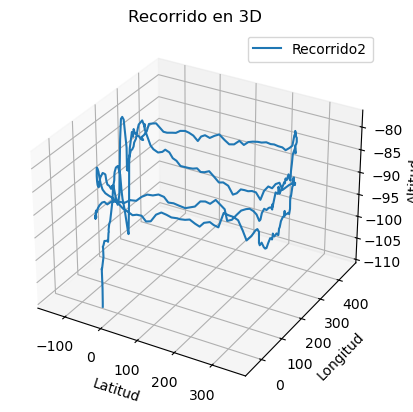

In [52]:
# Graficar el recorrido en 3D
fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')
#ax.plot(latitudes, longitudes, altitudes, label='Recorrido1')
ax.plot(disN, disE, disD, label='Recorrido2')
ax.set_xlabel('Latitud')
ax.set_ylabel('Longitud')
ax.set_zlabel('Altitud')
ax.set_title('Recorrido en 3D')
ax.legend()

## Beamwidth Measurement

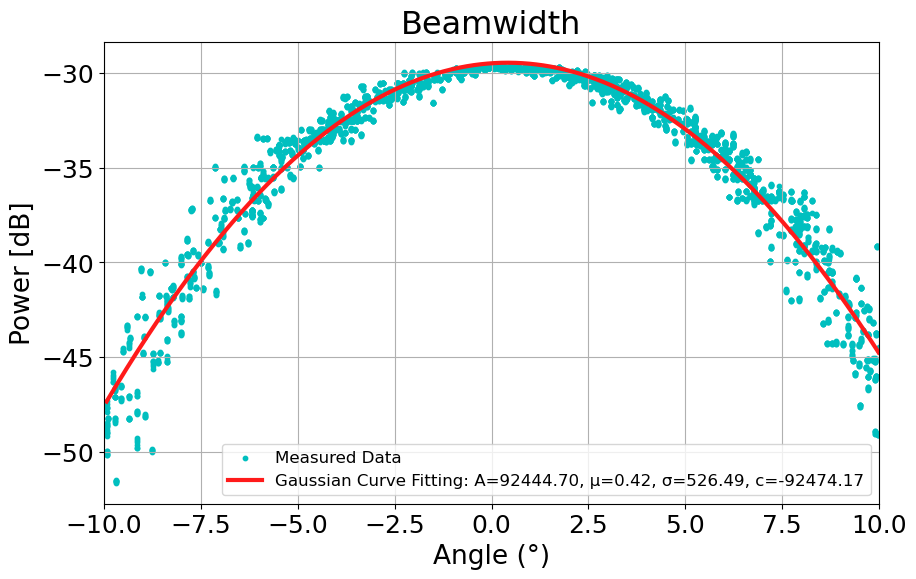

In [13]:
# Leer el archivo CSV
CSV = pd.read_csv(r'..\Data\BeamWidth\USRP01_BW_MEAS_19-07-2024-17-32-56.csv')

# Verificar si las columnas necesarias existen
if 'MAG' not in CSV.columns or 'PowerRx' not in CSV.columns:
    raise ValueError('El archivo CSV no contiene las columnas necesarias: MAG, PowerRx')

# Extraer las columnas en listas
AngleAci = np.array(CSV['MAG'])
Power = np.array(CSV['PowerRx'])

# Ajustar los ángulos
AngleAci_adjusted = np.where(AngleAci > 180, AngleAci - 360, AngleAci)

# Verificar si el array de Potencia está vacío
if len(Power) == 0:
    raise ValueError('El array de Potencia está vacío')

# Encontrar el valor máximo para el ajuste del ángulo
max_value = CSV.loc[CSV['PowerRx'].idxmax()]
Center = AngleAci_adjusted - max_value['MAG']

# Filtrar valores NaN e Inf
valid_indices = np.isfinite(Center) & np.isfinite(Power)
Center = Center[valid_indices]
Power = Power[valid_indices]

# Filtrar los valores de Center entre -10 y 10
filter_mask = (Center >= -10) & (Center <= 10)
Center_filtered = Center[filter_mask]
Power_filtered = Power[filter_mask]

# Verificar si los arrays filtrados están vacíos
if len(Center_filtered) == 0 or len(Power_filtered) == 0:
    raise ValueError('Los arrays filtrados están vacíos después de aplicar el límite.')

# Definir la función gaussiana
def gaussian(x, A, mu, sigma, const):
    return A * np.exp(- (x - mu)**2 / (2 * sigma**2)) + const

# Ajustar los parámetros iniciales
initial_guess = [max(Power_filtered), 0, 1, min(Power_filtered)]  # [A, mu, sigma, const]

# Ajustar la curva solo con los datos filtrados
try:
    popt, pcov = curve_fit(gaussian, Center_filtered, Power_filtered, p0=initial_guess, maxfev=10000)
except RuntimeError as e:
    print(f"Error: {e}")
    raise

# Extraer los parámetros ajustados
A, mu, sigma, const = popt

# Generar los valores x para la línea ajustada
x_fit = np.linspace(min(Center_filtered), max(Center_filtered), 1000)
y_fit = gaussian(x_fit, *popt)
plt.xlim(-10, 10)
# Graficar los datos filtrados y el ajuste gaussiano
plt.scatter(Center_filtered, Power_filtered, color='c', label='Measured Data',s=10)
plt.plot(x_fit, y_fit, color='#FF1A1A', label=f'Gaussian Curve Fitting: A={A:.2f}, μ={mu:.2f}, σ={sigma:.2f}, c={const:.2f}', linewidth=3)
plt.title('Beamwidth',fontsize=23)
plt.xlabel('Angle (°)',fontsize=19)
plt.ylabel('Power [dB]',fontsize=19)
plt.legend(fontsize=18)  # Ajusta el tamaño de la fuente de las etiquetas de la gráfica
plt.xticks(fontsize=18)
plt.yticks(fontsize=18)
plt.legend()
plt.show()


## Free space

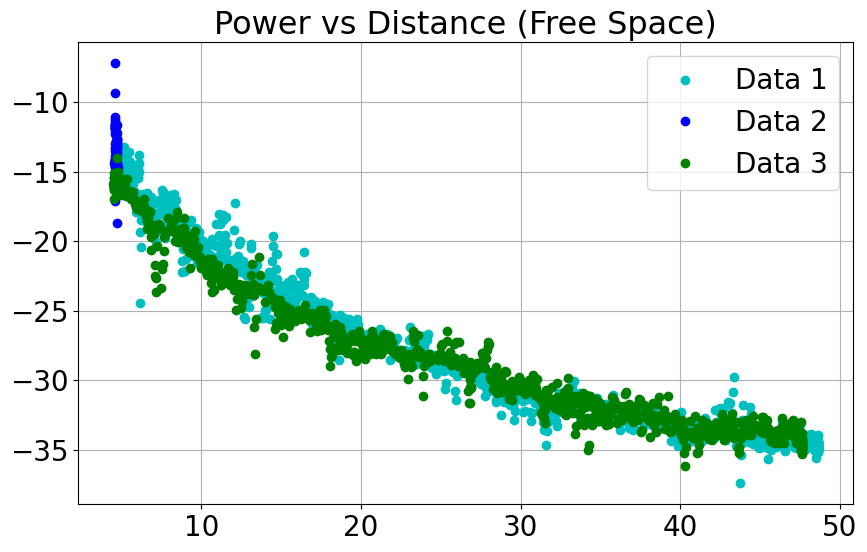

In [14]:

# Función para calcular la distancia Euclidiana para relPos
def calcular_distancia_relPos(df):
    # Convertir altitud a metros
    df['Distance'] = np.sqrt(
        df['R_N/Lon']**2 + df['R_E/Lat']**2 + (df['R_D/Hgt'])**2)
    return df

# Función para ajustar los valores de MAG para que estén dentro de -180 a 180 grados


def adjust_MAG(MAG, reference_MAG):
    adjusted_MAG = MAG - reference_MAG
    adjusted_MAG[adjusted_MAG > 180] -= 360
    adjusted_MAG[adjusted_MAG < -180] += 360
    return adjusted_MAG

# Función para corregir los valores de PowerRx basada en una ecuación proporcionada
def correct_PowerRx(row, beamwidth_func):
    correction = beamwidth_func(0) - beamwidth_func(row['MAG'])
    return row['PowerRx'] + correction

# Función para procesar cada archivo CSV
def procesar_archivo(csv_file, beamwidth_func, distanceB):
    df = pd.read_csv(csv_file)

    # Filtrar datos basados en PosType 'relPos'
    relPos_df = df[df['PosType'] == 'relPos'].copy()

    # Calcular distancias para relPos
    if not relPos_df.empty:
        relPos_df = calcular_distancia_relPos(relPos_df)

        max_power_idx_relPos = relPos_df['PowerRx'].idxmax()
        max_power_relPos = relPos_df.loc[max_power_idx_relPos]

        # Ajustar valores de MAG
        relPos_df['MAG'] = adjust_MAG(
            relPos_df['MAG'], max_power_relPos['MAG'])

        # Filtrar datos por MAG en el rango [-10, 10]
        relPos_df = relPos_df[(relPos_df['MAG'] >= -10)
                              & (relPos_df['MAG'] <= 10)]
        relPos_df = relPos_df[relPos_df['Distance'] > distanceB]

        # Corregir PowerRx basada en la función de ancho de haz
        relPos_df['PowerRx'] = relPos_df.apply(
            correct_PowerRx, axis=1, beamwidth_func=beamwidth_func)

        # Ordenar por distancia y PowerRx
        relPos_df = relPos_df.sort_values(
            by=['Distance', 'PowerRx'], ascending=[True, False])

        # Calcular la mediana de PowerRx para cada distancia
        relPos_df = relPos_df.groupby(
            'Distance')['PowerRx'].median().reset_index()

    return relPos_df


# Listado de archivos CSV
archivos_csv = [
    r'..\Data\5G_loss\5G_loss_MEAS_01-08-2024\5G_loss_MEAS_01-08-2024-12-58-35.csv',
    r'..\Data\5G_loss\5G_loss_MEAS_01-08-2024\5G_loss_MEAS_01-08-2024-13-03-11.csv',
    r'..\Data\5G_loss\5G_loss_MEAS_01-08-2024\5G_loss_MEAS_01-08-2024-13-10-13.csv'
]

# Definir la función de ancho de haz


def beamwidth_func(MAG): return 133800.55 * np.exp(- (MAG - 0.42)
                                                   ** 2 / (2 * 633.4**2))  # Función de ejemplo


# Colores para diferenciar cada archivo en la gráfica
colores = ['c', 'b', 'g', 'r', 'm', 'y']

# Inicializar lista para almacenar resultados
relPos_data = []

# Procesar cada archivo y almacenar los resultados
for i, csv_file in enumerate(archivos_csv):
    relPos_df = procesar_archivo(csv_file, beamwidth_func, 0)
    relPos_data.append((relPos_df, colores[i]))

# Graficar PowerRx en función de la distancia para relPos
plt.figure(figsize=(10, 6))
for i, (relPos_df, color) in enumerate(relPos_data):
    plt.plot(relPos_df['Distance'], relPos_df['PowerRx'], label=f'Data {i+1}', marker='o', color=color, linestyle=' ')

plt.title('Power vs Distance (Free Space)',fontsize=23)
plt.legend(fontsize=20, loc="upper right")
plt.xticks(fontsize=20)
plt.yticks(fontsize=20)
plt.grid(True)
plt.show()

## Linearization


$$\begin{equation}
    \begin{matrix}
        P_{sig}^{Rx} = \displaystyle\frac{P_{TX}\cdot G_T\cdot G_R \cdot K_{Rx} }{\left(\frac{4\pi R}{\lambda}\right)^2} = \displaystyle\frac{A}{\left(\frac{4\pi R}{\lambda}\right)^2}
    \end{matrix}
\end{equation}
$$

$$
\begin{equation}
    P_{sig}^{Rx} (dB) = 10\log_{10}\left(A \right) - 20\log_{10}\left(4\pi R/\lambda\right)
\end{equation}
$$

$$
\begin{equation}
     \left.P_{sig}^{Rx} (dB)\right|_{R=1m} = 10\log_{10}\left(A \right) - 20\log_{10}\left(4\pi/\lambda\right)
\end{equation}
$$

C:\Users\JuliansCastro\AppData\Local\Temp\ipykernel_2984\708230006.py:111: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  fin = float(x_value[99])


7036854.381741264


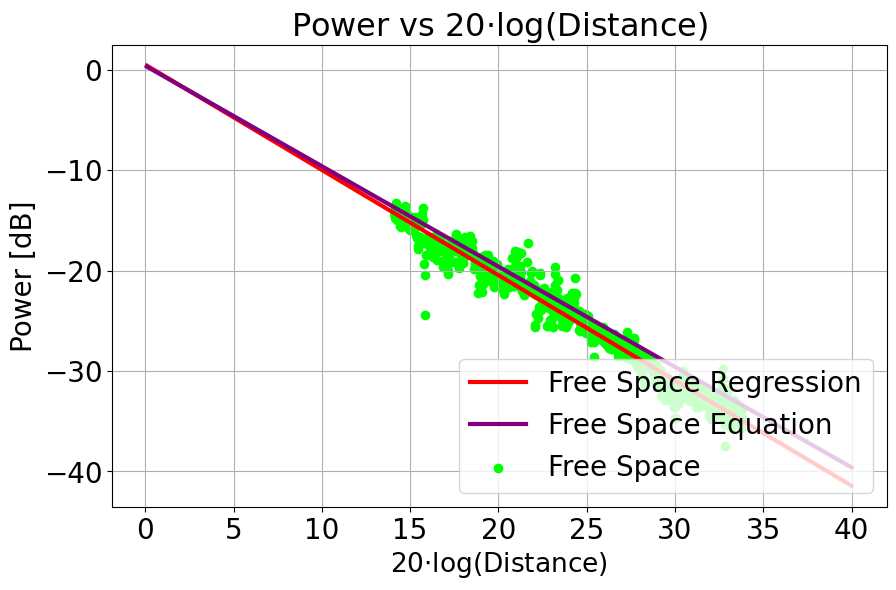

In [15]:
# Función para calcular la distancia Euclidiana para relPos
def calcular_distancia_relPos(df):
    # Convertir altitud a metros
    df['Distance'] = np.sqrt(df['R_N/Lon']**2 + df['R_E/Lat']**2 + (df['R_D/Hgt'])**2)
    return df

# Función para ajustar los valores de MAG para que estén dentro de -180 a 180 grados


def adjust_MAG(MAG, reference_MAG):
    adjusted_MAG = MAG - reference_MAG
    adjusted_MAG[adjusted_MAG > 180] -= 360
    adjusted_MAG[adjusted_MAG < -180] += 360
    return adjusted_MAG

# Función para corregir los valores de PowerRx basada en una ecuación proporcionada


def correct_PowerRx(row, beamwidth_func):
    correction = beamwidth_func(0) - beamwidth_func(row['MAG'])
    return row['PowerRx'] + correction

# Función para procesar cada archivo CSV


def procesar_archivo(csv_file, beamwidth_func, distanceB):
    df = pd.read_csv(csv_file)

    # Filtrar datos basados en PosType 'relPos'
    relPos_df = df[df['PosType'] == 'relPos'].copy()

    # Calcular distancias para relPos
    if not relPos_df.empty:
        relPos_df = calcular_distancia_relPos(relPos_df)

        max_power_idx_relPos = relPos_df['PowerRx'].idxmax()
        max_power_relPos = relPos_df.loc[max_power_idx_relPos]

        # Ajustar valores de MAG
        relPos_df['MAG'] = adjust_MAG(
            relPos_df['MAG'], max_power_relPos['MAG'])

        # Filtrar datos por MAG en el rango [-10, 10]
        relPos_df = relPos_df[(relPos_df['MAG'] >= -10)
                              & (relPos_df['MAG'] <= 10)]
        relPos_df = relPos_df[relPos_df['Distance'] > distanceB]

        # Corregir PowerRx basada en la función de ancho de haz
        relPos_df['PowerRx'] = relPos_df.apply(
            correct_PowerRx, axis=1, beamwidth_func=beamwidth_func)

        # Ordenar por distancia y PowerRx
        relPos_df = relPos_df.sort_values(
            by=['Distance', 'PowerRx'], ascending=[True, False])

        # Calcular la mediana de PowerRx para cada distancia
        relPos_df = relPos_df.groupby(
            'Distance')['PowerRx'].median().reset_index()

    return relPos_df


# Listado de archivos CSV
archivos_csv = [
    r'..\Data\5G_loss\5G_loss_MEAS_01-08-2024\5G_loss_MEAS_01-08-2024-12-58-35.csv',
    # r'..\Data\5G_loss\5G_loss_MEAS_01-08-2024\5G_loss_MEAS_01-08-2024-13-03-11.csv',
    # r'..\Data\5G_loss\5G_loss_MEAS_01-08-2024\5G_loss_MEAS_01-08-2024-13-10-13.csv'
]


# Definir la función de ancho de haz


def beamwidth_func(MAG): return 133800.55 * np.exp(- (MAG - 0.42)** 2 / (2 * 633.4**2))  # Función de ejemplo


# Colores para diferenciar cada archivo en la gráfica
colores = ['c', 'b', 'g', 'r', 'm', 'y']

# Inicializar lista para almacenar resultados
relPos_data = []

# Procesar cada archivo y almacenar los resultados
for i, csv_file in enumerate(archivos_csv):
    relPos_df = procesar_archivo(csv_file, beamwidth_func, 0)
    relPos_data.append((relPos_df, colores[i]))

# Graficar PowerRx en función de la distancia para relPos
plt.figure(figsize=(10, 6))
for i, (relPos_df, color) in enumerate(relPos_data):
    # Convertir distancia a logaritmo
    log_distance = 20 * np.log10(relPos_df['Distance']).values.reshape(-1, 1)

    # Crear un rango de valores logarítmicos para la predicción
    x_value = np.linspace(0.1, 40, 20000).reshape(-1, 1)

    # Ajustar el modelo de regresión lineal
    model = LinearRegression()
    model.fit(log_distance, relPos_df['PowerRx'])
    model.get_params()

    # Predecir valores de PowerRx
    y_pred = model.predict(x_value)
    P0 = float(y_pred[0])
    c = 299792458     # En m/s
    fc = 60.48e9  # en Hz
    wlenght = c/fc   # Lambda
    A = 10**((P0+20*np.log10(4*np.pi/wlenght))/10)
    P = 10*np.log10(A)-20*np.log10(4*np.pi/wlenght)-x_value
    Pf = float(y_pred[99])
    fin = float(x_value[99])
    print(A)

    plt.plot(x_value, y_pred, label=f'Free Space Regression', color='r',linewidth=3) #LogLog Fig8
    plt.plot(x_value, P, label=f'Free Space Equation', color='#800080', linewidth=3) #LogLog fig8
    plt.scatter(log_distance, relPos_df['PowerRx'], label=f'Free Space', marker='o', color='#00FF00') #LogLog Fig8



def Power_Losses(x, alpha):  # Function of signal Rx Power with losses
    return 10*np.log10(A/((4*np.pi*10**(x/20)/wlenght)**2))+10*np.log10(np.e**(-2*alpha*10**(x/20)))

# def PL_InHModel(x, a, b):
#     f_x = a+b*np.log10(x)+20.0*np.log10(fc)
#     return f_x


def PL_InHModel(x, a, b, c):
    f_x = a+b*np.log10(x)+20.0*np.log10((fc*1e-9))+c * \
        ((fc*1e-9)**0.248)*(x**0.588)*0
    return f_x


plt.xlabel('20$\cdot$log(Distance)',fontsize=19)#Fig8
plt.ylabel('Power [dB]',fontsize=20) #Fig8
plt.title('Power vs 20$\cdot$log(Distance)',fontsize=23)# Fig8
# Ajusta el tamaño de la fuente de las etiquetas de la gráfica
plt.legend(fontsize=20, loc="lower right")
plt.xticks(fontsize=20)
plt.yticks(fontsize=20)
plt.grid(True)
plt.show()

## Path Loss Analyses


C:\Users\JuliansCastro\AppData\Local\Temp\ipykernel_2984\3695816136.py:21: OptimizeWarning: Covariance of the parameters could not be estimated
  a, b = curve_fit(PL_InHModel, CSV_df['Distance'], PL_meas)
C:\Users\JuliansCastro\AppData\Local\Temp\ipykernel_2984\3695816136.py:34: OptimizeWarning: Covariance of the parameters could not be estimated
  a1, b1 = curve_fit(PL_InHModel, CSV1_df['Distance'], PL1_meas)


[-17.22550262  66.59837034   1.        ]


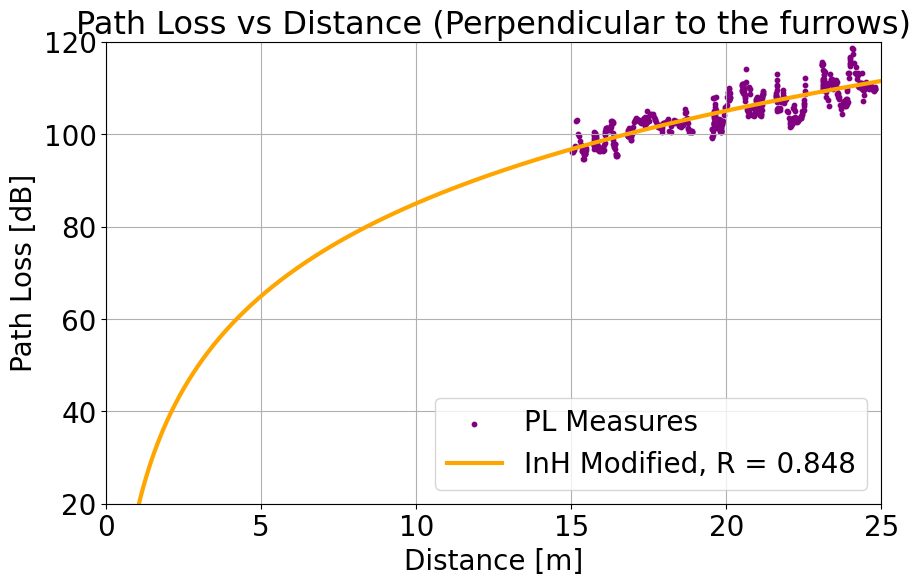

In [16]:
# CSV = r'..\Data/5G_loss/5G_loss_MEAS_20-08-2024-14-23-43.csv'   #Greenhouse 4
CSV = r'..\Data\5G_loss\5G_loss_MEAS_20-08-2024\5G_loss_MEAS_20-08-2024-13-17-20.csv'  # Greenhouse 3
# CSV = r'..\Data\5G_loss\5G_loss_MEAS_08-08-2024\5G_loss_MEAS_08-08-2024-10-53-18.csv' # Greenhouse1
CSV1 = r'..\Data\5G_loss\5G_loss_MEAS_08-08-2024\5G_loss_MEAS_08-08-2024-11-43-57.csv'  # Greenhouse2

CSV_df = procesar_archivo(CSV, beamwidth_func, 15)
CSV1_df = procesar_archivo(CSV1, beamwidth_func, 0)

PL_meas = 1-(CSV_df['PowerRx']-10*np.log10(A))

CSV_log = 20 * np.log10(CSV_df['Distance'])
alpha, a_var = curve_fit(Power_Losses, CSV_log, CSV_df['PowerRx'].values)
x_value = np.linspace(0.1, 40, 20000)
PL = 1-10*np.log10((np.e**(-2*alpha*x_value)) /
                   (4*np.pi*x_value/wlenght)**2)  # Path Loss custom model

PL1 = 1-10 * \
    np.log10((np.e**(-2*alpha*CSV_df['Distance'])) /
             (4*np.pi*CSV_df['Distance']/wlenght)**2)

a, b = curve_fit(PL_InHModel, CSV_df['Distance'], PL_meas)
print(a)
correlation = np.corrcoef(PL_meas, PL_InHModel(
    CSV_df['Distance'], a[0], a[1], a[2]))[0, 1]
correlation = round(correlation, 3)

###

PL1_meas = 1-(CSV1_df['PowerRx']-10*np.log10(A))

CSV1_log = 20 * np.log10(CSV1_df['Distance'])
alpha1, a_var1 = curve_fit(Power_Losses, CSV1_log, CSV1_df['PowerRx'].values)

a1, b1 = curve_fit(PL_InHModel, CSV1_df['Distance'], PL1_meas)
correlation1 = np.corrcoef(PL1_meas, PL_InHModel(
    CSV1_df['Distance'], a1[0], a1[1], a1[2]))[0, 1]
correlation1 = round(correlation1, 3)

plt.figure(figsize=(10, 6))

plt.xlim(0, 25)  # Reemplaza min_x y max_x con los valores deseados
plt.ylim(20, 120)  # Reemplaza min_y y max_y con los valores deseados

## Perpendicular 

plt.scatter(CSV_df['Distance'], PL_meas, label=f'PL Measures', color='#800080', s=10)
plt.plot(x_value, PL_InHModel(x_value, a[0], a[1], a[2]), label=f'InH Modified, R = {correlation}', color='#FFA500', linewidth=3)  # 3GPP base model

## Paralelo

# plt.scatter(CSV_df['Distance'], PL_meas,label=f'Measures with metal structrue', color='#66CC66', s=10)
# plt.plot(x_value, PL_InHModel(x_value,a[0],a[1], a[2]), label=f'Fitted InH with metal structrue, R = {correlation}', color='#4169E1', linewidth=3) # 3GPP base model
# plt.scatter(CSV1_df['Distance'], PL1_meas,label=f'Measures without metal structure', color='#FFC0CB', s=10)
# plt.plot(x_value, PL_InHModel(x_value,a1[0],a1[1], a1[2]), label=f'Fitted InH without metal structure, R = {correlation1}', color='#DC143C', linewidth=3) # 3GPP base model




plt.xlabel('Distance [m]', fontsize=20)
plt.ylabel('Path Loss [dB]', fontsize=20)

plt.title('Path Loss vs Distance (Perpendicular to the furrows)', fontsize=23)
plt.legend(fontsize=20, loc="lower right")
plt.xticks(fontsize=20)
plt.yticks(fontsize=20)
plt.grid(True)
plt.show()